<a href="https://colab.research.google.com/github/Melissa-cv/SEGUIMIENTO-4_Melissa-Daniel-Diego/blob/main/Seguimiento4_DanielSoto_DiegoFlorez_MelissaCadavid.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<p><img alt="udeA logo" height="150px" src="https://github.com/freddyduitama/images/blob/master/logo.png?raw=true" align="left" hspace="50px" vspace="0px" style="width:107px;height:152px;"></p>
<h1><font color='0B5345'> <center>
Bioseñales y Sistemas </center></font></h1>
<h2><font color='0B5345'> <center>
Seguimiento 4  </center></font></h2>
<h3><font color='0B5345'> <center>
Melissa Cadavid - Diego Andrés Flórez - Daniel Felipe Soto </center></font></h3>
<font  face="Courier New" size="3">
<p1><center> </center></p1>



<p3><center><b><font color='0B5345' face="Lucida Calligraphy,Comic Sans MS,Lucida Console" size="5">Universidad de Antioquia</font></b> </center></p3>
</font>

Carga, procesamiento y visualización de datos de EMG almacenados en archivos .txt en múltiples carpetas dentro de Google Drive.
Gráfica de cada canal con respecto al tiempo
Gráfica de cada canal con TKEO con respecto al tiempo.

In [ ]:
from google.colab import drive
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Montar Google Drive
drive.mount('/content/drive')

# Ruta base donde están las carpetas
base_path = '/content/drive/MyDrive/PROYECTO FINAL/EMG_data_for_gestures-master'

# Función para aplicar el operador TKEO
def apply_tkeo(signal):
    tkeo_signal = np.zeros_like(signal)
    tkeo_signal[1:-1] = signal[1:-1]**2 - signal[:-2] * signal[2:]
    return tkeo_signal

# Iterar sobre las carpetas del 01 al 36
for folder_name in [f'{i:02d}' for i in range(1, 37)]:
    folder_path = os.path.join(base_path, folder_name)

    # Verificar si la carpeta existe
    if os.path.exists(folder_path):
        # Iterar sobre los archivos de texto en la carpeta
        for file_name in os.listdir(folder_path):
            if file_name.endswith('.txt'):
                # Leer el archivo TXT en un DataFrame, omitiendo la primera fila
                file_path = os.path.join(folder_path, file_name)
                df = pd.read_csv(file_path, sep='\t', skiprows=1)

                # Asignar nombres de columna manualmente
                columns = ['Tiempo'] + [f'Canal_{i}' for i in range(1, 9)] + ['Clase']
                df.columns = columns

                # Convertir la columna de tiempo a numérica
                df['Tiempo'] = pd.to_numeric(df['Tiempo'], errors='coerce')


Mounted at /content/drive


# b. (10%) Definir una estrategia de filtrado de las señales del proyecto 1 usando filtros IIR o FIR justificando la selección (10%)


En aplicaciones que buscan clasificar gestos basándose en lecturas de electromiografía (EMG), la elección del filtro adecuado desempeña un papel crucial en la captura precisa de las características de la señal EMG. En este contexto, donde la precisión y la eficiencia son fundamentales, surge la pregunta: ¿deberíamos utilizar un filtro IIR (Infinite Impulse Response) o un filtro FIR (Finite Impulse Response)?

Las señales EMG son conocidas por contener componentes de alta frecuencia, especialmente en respuesta a movimientos musculares rápidos. Por lo tanto, es esencial seleccionar un filtro que preserve estas características de alta frecuencia para capturar adecuadamente la dinámica de los gestos. Además, dado que el objetivo es construir una red neuronal para clasificar gestos, minimizar la latencia del filtro es esencial para garantizar una respuesta en tiempo real. La linealidad de fase también es importante para preservar la sincronización temporal de las señales EMG, lo que puede ser crucial para una clasificación precisa de gestos.

En este contexto, los filtros FIR serian una opcion importante. Los filtros FIR pueden ser diseñados para tener una respuesta de frecuencia plana en un amplio rango de frecuencias, lo que permite preservar las características de alta frecuencia de la señal EMG. Además, los filtros FIR pueden ser diseñados para tener una fase lineal.

los filtros FIR,Ademas, son inherentemente estables y su diseño es relativamente simple en comparación con los filtros IIR. Esto hace que los filtros FIR sean una opción mas viable.

FILTRO SELECCIONADO: **FIR**




# **Cálculo de la Duración Total de la Señal:**
La señal EMG se registra mientras los sujetos realizan gestos estáticos con las manos utilizando una pulsera Myo Thalmic equipada con ocho sensores de EMG. Cada serie de gestos consta de seis (siete) gestos básicos, realizados durante 3 segundos cada uno, con una pausa de 3 segundos entre gestos. Considerando que hay dos series por sujeto, la duración total de la señal se calcula multiplicando la duración de una serie por el número de series. Por lo tanto, la duración total de la señal es de 84 segundos:


La duración total de la señal se determina considerando la duración de cada gesto y la pausa entre gestos, así como el número de gestos y series realizadas.

1. Duración de cada gesto: Se menciona que cada gesto se realiza durante 3 segundos.
2. Pausa entre gestos: También se especifica que hay una pausa de 3 segundos entre gestos.
3. Número de gestos: Se menciona que cada serie consta de seis gestos básicos.
4. Número de series: Se indica que hay dos series por sujeto.

Entonces, para calcular la duración total de la señal:

Duración total de una serie = (Duración de un gesto + Pausa entre gestos) * (Número de gestos) = (3 segundos + 3 segundos) * 7 gestos = 42 segundos

Como hay dos series, la duración total de la señal es:

Duración total de la señal = 42 segundos * 2 series = 84 segundos

Por lo tanto, la duración total de la señal es de 84 segundos.

# **Determinación de la Frecuencia de Muestreo:**

1. **Número Total de Muestras (N):** Para determinar cuántas muestras se necesitan para toda la duración de la señal, multiplicamos la frecuencia de muestreo deseada por la duración total de la señal. Esta es la cantidad total de puntos de datos que necesitamos tomar para representar la señal.

  N=FsXDuracion Total de la señal

2. **Cálculo de la Frecuencia de Muestreo (Fs):** Dado que conocemos la duración total de la señal y queremos una resolución de muestreo de al menos 100 muestras por segundo, podemos reorganizar la fórmula anterior para calcular la frecuencia de muestreo necesaria.


La fórmula general para calcular la frecuencia de muestreo es:

Fs=N/Duracion total de la señal

Donde:
- Fs es la frecuencia de muestreo.
- N es el número total de muestras.
- Duración Total de la Señal es la duración total de la señal.

En este caso, queremos que la frecuencia de muestreo (Fs) sea de al menos 100 muestras por segundo. Entonces, podemos reorganizar la fórmula de la siguiente manera:

100 = N/84 segundos

Ahora, para calcular el número total de muestras (N), simplemente multiplicamos la frecuencia de muestreo deseada (100 muestras por segundo) por la duración total de la señal (84 segundos):

N = 8400

Entonces, la frecuencia de muestreo (Fs) necesaria para capturar adecuadamente la señal EMG durante toda su duración de 84 segundos con una resolución de al menos 100 muestras por segundo es de 100 Hz.



**Entonces, el orden del filtro pasa altas sería:**

Orden= (10Hz/100Hz)*3.3 =0.33

Como el orden del filtro debe ser un número entero, podemos redondear hacia arriba al número entero más cercano. En este caso, el orden del filtro sería 1.

El número de coeficientes necesarios para un filtro FIR (Respuesta al Impulso Finita) de orden \( M \) es \( M + 1 \). Por lo tanto, el número de coeficientes necesarios para un filtro pasa altas de orden 1 sería \( 1 + 1 = 2 \).

Entonces, necesitamos 2 coeficientes para diseñar un filtro pasa altas con una ventana Hamming, con una frecuencia de corte de 40 Hz y una frecuencia de muestreo de 100 Hz.

**el ordden del filtro pasa bajas seria: **

Orden= (40Hz/100Hz)*3.3 =1.32

Como el orden del filtro debe ser un número entero, podemos redondear hacia arriba al número entero más cercano. En este caso, el orden del filtro sería 2.

El número de coeficientes necesarios para un filtro FIR (Respuesta al Impulso Finita) de orden \( M \) es \( M + 1 \). Por lo tanto, el número de coeficientes necesarios para un filtro pasa bajas de orden 2 sería \( 2 + 1 = 3 \).

Entonces, necesitamos 3 coeficientes para diseñar un filtro pasa bajas con una ventana Hamming, con una frecuencia de corte de 40 Hz y una frecuencia de muestreo de 100 Hz.

<ipython-input-16-fe2d865f9509>:24: RuntimeWarning: divide by zero encountered in log10
  plt.plot(frequencies, 20 * np.log10(np.abs(freq_response)))


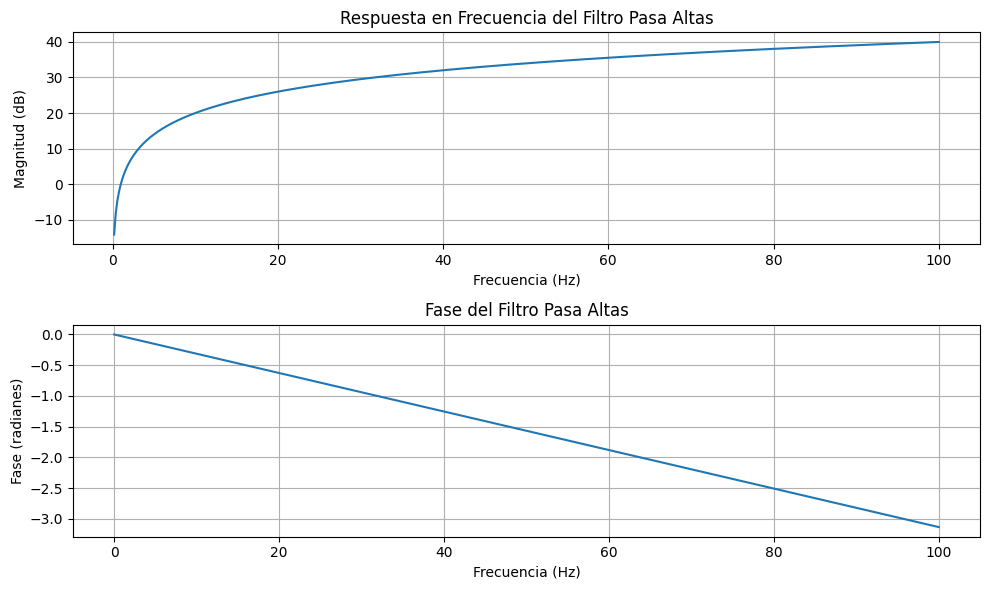

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import freqz, firwin

# Parámetros del filtro pasa altas
order_highpass = 2
cutoff_freq_highpass = 10  # Frecuencia de corte del filtro pasa altas en Hz

# Frecuencia de muestreo de las señales EMG
sampling_freq = 200  # Hz

# Diseñar el filtro pasa altas utilizando la ventana de Hamming
fir_coefficients_highpass = firwin(order_highpass + 1, cutoff_freq_highpass, fs=sampling_freq, pass_zero=False, window='hamming')

# Calcular la respuesta en frecuencia y la fase del filtro pasa altas
freq_response, phase_response = freqz(fir_coefficients_highpass, fs=sampling_freq)

# Calcular las frecuencias de muestreo correspondientes
frequencies = np.linspace(0, 0.5 * sampling_freq, len(freq_response))

# Trama de la respuesta en frecuencia del filtro pasa altas
plt.figure(figsize=(10, 6))
plt.subplot(2, 1, 1)
plt.plot(frequencies, 20 * np.log10(np.abs(freq_response)))
plt.title('Respuesta en Frecuencia del Filtro Pasa Altas')
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('Magnitud (dB)')
plt.grid()

# Trama de la fase del filtro pasa altas
plt.subplot(2, 1, 2)
plt.plot(frequencies, np.unwrap(np.angle(phase_response)))
plt.title('Fase del Filtro Pasa Altas')
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('Fase (radianes)')
plt.grid()

plt.tight_layout()
plt.show()


<ipython-input-17-00b01c7e0ae8>:11: RuntimeWarning: divide by zero encountered in log10
  plt.plot(frequencies_flipped, 20 * np.log10(np.abs(freq_response_flipped)))


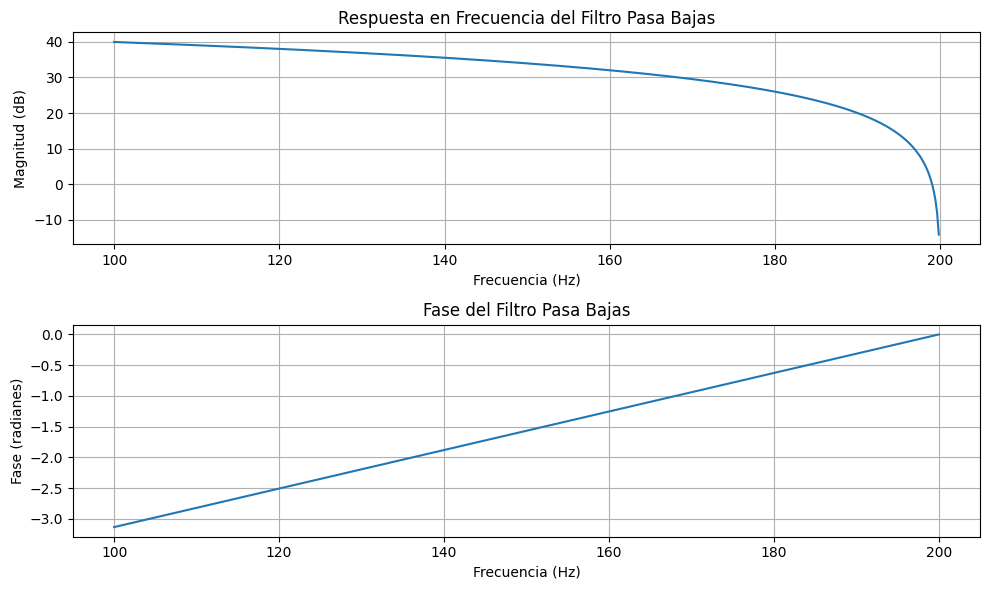

In [ ]:
# Reflejar la respuesta en frecuencia y la fase para obtener el rango correcto
freq_response_flipped = np.flip(freq_response)
phase_response_flipped = np.flip(phase_response)

# Reflejar las frecuencias también
frequencies_flipped = np.flip(sampling_freq - frequencies)

# Trama de la respuesta en frecuencia del filtro pasa bajas
plt.figure(figsize=(10, 6))
plt.subplot(2, 1, 1)
plt.plot(frequencies_flipped, 20 * np.log10(np.abs(freq_response_flipped)))
plt.title('Respuesta en Frecuencia del Filtro Pasa Bajas')
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('Magnitud (dB)')
plt.grid()

# Trama de la fase del filtro pasa bajas
plt.subplot(2, 1, 2)
plt.plot(frequencies_flipped, np.unwrap(np.angle(phase_response_flipped)))
plt.title('Fase del Filtro Pasa Bajas')
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('Fase (radianes)')
plt.grid()

plt.tight_layout()
plt.show()


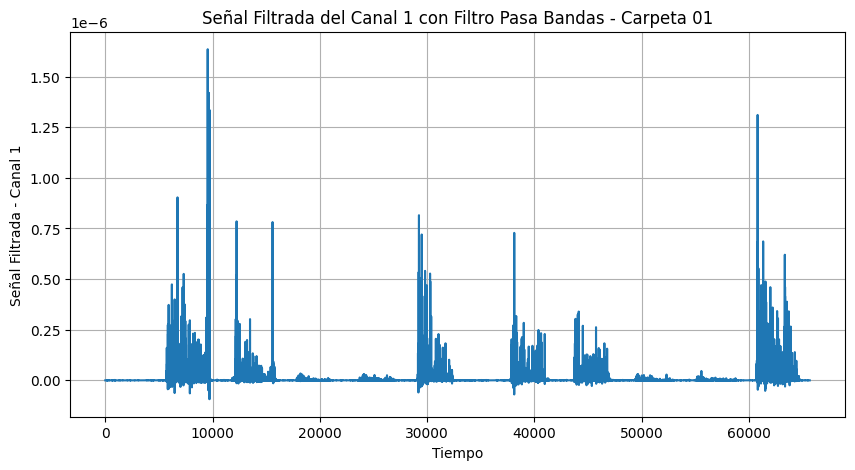

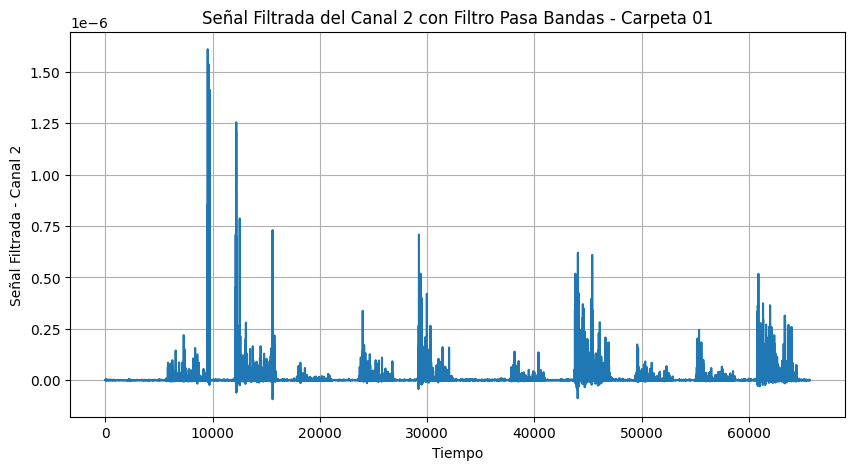

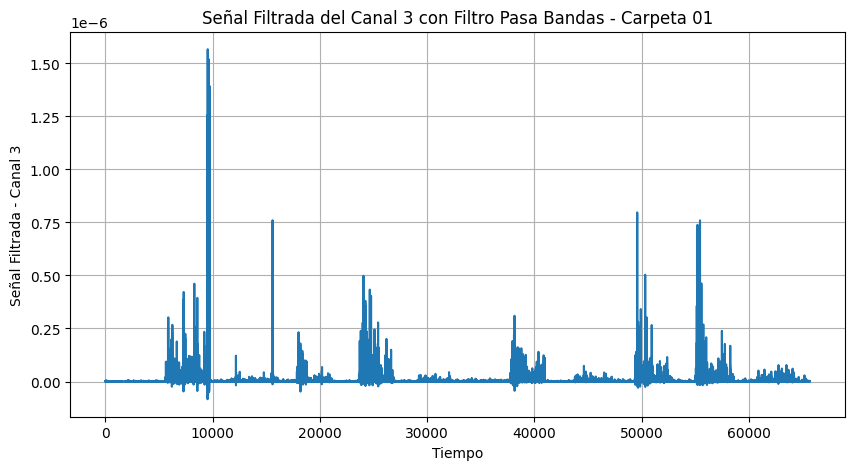

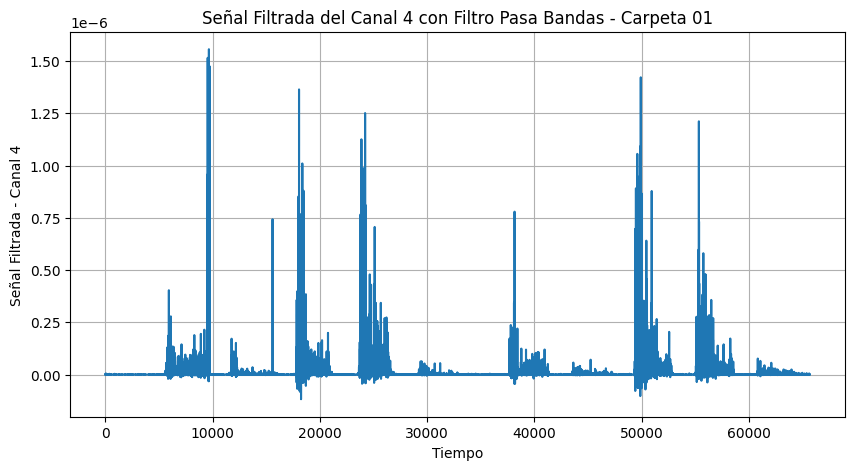

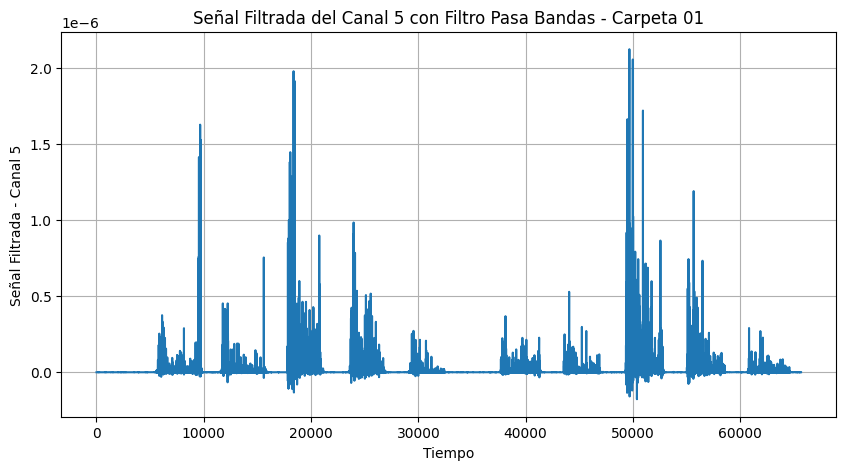

...

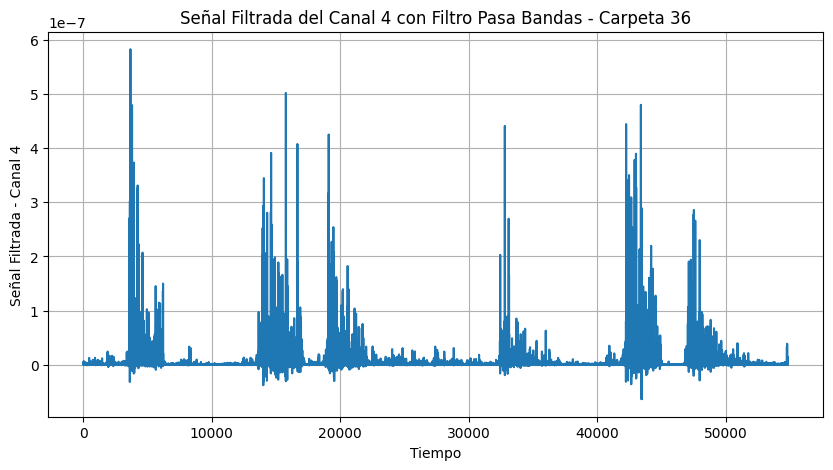

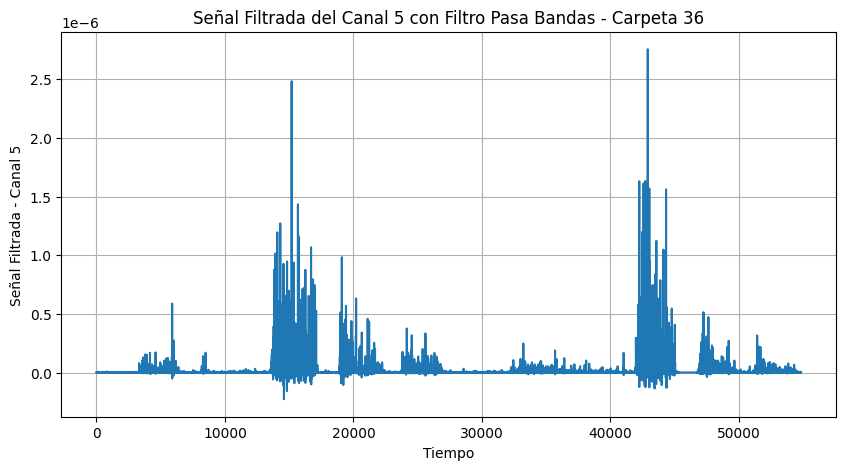

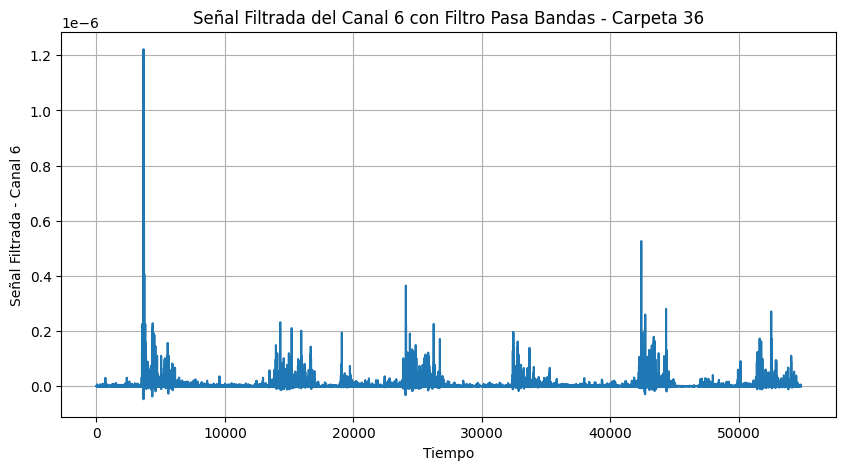

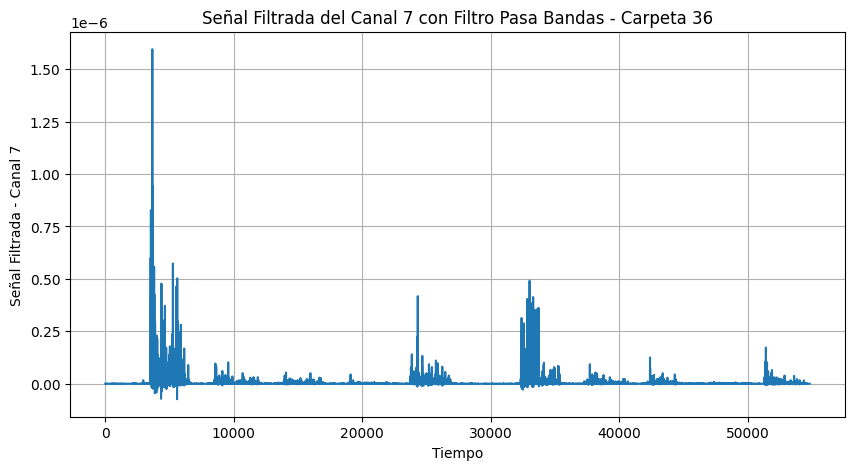

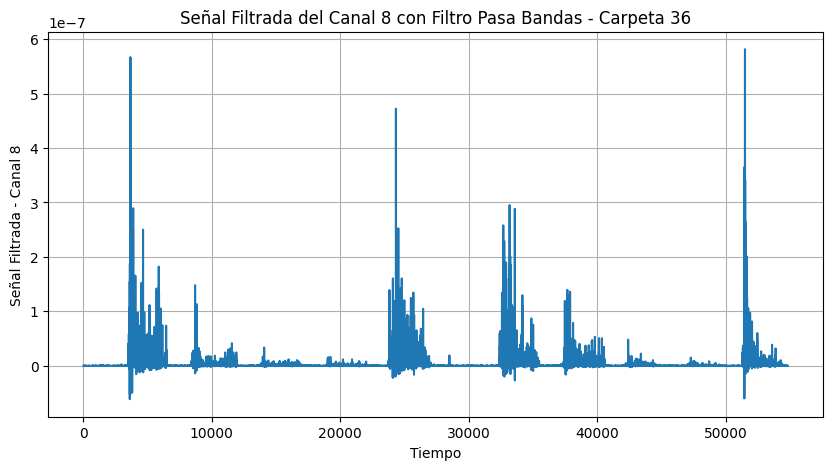

In [ ]:
from scipy.signal import firwin, convolve

# Definir los parámetros del filtro pasa altas
order_highpass = 2
cutoff_freq_highpass = 10  # Frecuencia de corte del filtro pasa altas en Hz

# Definir los parámetros del filtro pasa bajas
order_lowpass = 3
cutoff_freq_lowpass = 40  # Frecuencia de corte del filtro pasa bajas en Hz

# Frecuencia de muestreo de las señales EMG
sampling_freq = 200  # Hz

# Diseñar los filtros FIR utilizando la ventana de Hamming
fir_coefficients_highpass = firwin(order_highpass + 1, cutoff_freq_highpass, fs=sampling_freq, pass_zero=False, window='hamming')
fir_coefficients_lowpass = firwin(order_lowpass + 1, cutoff_freq_lowpass, fs=sampling_freq, window='hamming')

# Combinar los filtros pasa altas y pasa bajas para obtener el filtro pasa bandas
fir_coefficients_bandpass = convolve(fir_coefficients_highpass, fir_coefficients_lowpass, mode='full')

# Iterar sobre las carpetas del 01 al 36
for folder_name in [f'{i:02d}' for i in range(1, 37)]:
    folder_path = os.path.join(base_path, folder_name)

    # Verificar si la carpeta existe
    if os.path.exists(folder_path):
        # Iterar sobre los archivos de texto en la carpeta
        for file_name in os.listdir(folder_path):
            if file_name.endswith('.txt'):
                # Leer el archivo TXT en un DataFrame, omitiendo la primera fila
                file_path = os.path.join(folder_path, file_name)
                df = pd.read_csv(file_path, sep='\t', skiprows=1)

                # Asignar nombres de columna manualmente
                columns = ['Tiempo'] + [f'Canal_{i}' for i in range(1, 9)] + ['Clase']
                df.columns = columns

                # Convertir la columna de tiempo a numérica
                df['Tiempo'] = pd.to_numeric(df['Tiempo'], errors='coerce')

                # Iterar sobre cada canal, aplicar TKEO y luego aplicar el filtro pasa bandas
                for channel in range(1, 9):
                    # Aplicar TKEO al canal
                    tkeo_signal = apply_tkeo(df[f'Canal_{channel}'].values)

                    # Aplicar el filtro pasa bandas
                    filtered_signal_bandpass = convolve(tkeo_signal, fir_coefficients_bandpass, mode='same')

                    # Graficar la señal filtrada
                    plt.figure(figsize=(10, 5))
                    plt.plot(df['Tiempo'], filtered_signal_bandpass)
                    plt.xlabel('Tiempo')
                    plt.ylabel(f'Señal Filtrada - Canal {channel}')
                    plt.title(f'Señal Filtrada del Canal {channel} con Filtro Pasa Bandas - Carpeta {folder_name}')
                    plt.grid(True)
                    plt.show()


Este bloque es una prueba para verificar que si se realiza el proceso de manera adecuada .de código aplica el filtro FIR a las señales después de haberles aplicado el operador TKEO. Los coeficientes del filtro FIR se convolucionan con cada señal TKEO para obtener la señal filtrada resultante. Luego, se grafican las señales filtradas después de TKEO para cada canal.

# **c. (10%) Obtener los índices del proyecto 1 usando la señal filtrada (Después de aplicar señal TKEO). Comparar los índices obtenidos de la señal filtrada con los obtenidos en el proyecto 1 (Señal con Operador TKEO) usando gráficos de Análisis Exploratorio de Datos (10%)**

Una vez cerificado el procedimiento en el bloque de codigo anterior, **Se crea un DataFrame que contiene las señales filtradas después de aplicar el operador TKEO y el filtro para cada canal en cada archivo de texto.** ademas de un Data frame donde no hayamos aplicado el filtro para obtener las metricas del proyecto 1.

In [ ]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

def apply_tkeo(signal):
    """Aplicar el operador de energía de Teager-Kaiser (TKEO) a una señal."""
    tkeo_signal = np.zeros_like(signal)
    tkeo_signal[1:-1] = signal[1:-1] ** 2 - signal[:-2] * signal[2:]
    return tkeo_signal

# Ruta base donde están las carpetas
base_path = '/content/drive/MyDrive/PROYECTO FINAL/EMG_data_for_gestures-master'

# Inicializar una lista para almacenar todos los datos
all_data_tkeo = []

# Iterar sobre las carpetas del 01 al 36
for folder_name in [f'{i:02d}' for i in range(1, 37)]:
    folder_path = os.path.join(base_path, folder_name)

    # Verificar si la carpeta existe
    if os.path.exists(folder_path):
        # Iterar sobre los archivos de texto en la carpeta
        for file_name in os.listdir(folder_path):
            if file_name.endswith('.txt'):
                # Leer el archivo TXT en un DataFrame, omitiendo la primera fila
                file_path = os.path.join(folder_path, file_name)
                df = pd.read_csv(file_path, sep='\t', skiprows=1)

                # Asignar nombres de columna manualmente
                columns = ['Tiempo'] + [f'Canal_{i}' for i in range(1, 9)] + ['Clase']
                df.columns = columns

                # Convertir la columna de tiempo a numérica
                df['Tiempo'] = pd.to_numeric(df['Tiempo'], errors='coerce')

                # Aplicar TKEO a cada canal, excepto a la columna de tiempo y de clase
                for channel in range(1, 9):
                    if f'Canal_{channel}' not in ['Tiempo', 'Clase']:
                        # Aplicar TKEO al canal
                        tkeo_signal = apply_tkeo(df[f'Canal_{channel}'].values)

                        # Reemplazar el canal original con la señal TKEO en el DataFrame
                        df[f'Canal_{channel}'] = tkeo_signal

                # Agregar los datos al DataFrame
                all_data_tkeo.append(df)

# Concatenar todos los DataFrames en uno solo
df_Crudo = pd.concat(all_data_tkeo, ignore_index=True)

# Definir las clases en el orden especificado
clases = [1, 2, 3, 4, 5, 6, 7]  # Mano en reposo, Mano cerrada en un puño, Flexión de muñeca, Extensión de muñeca, Desviaciones radiales, Desviaciones cubitales, Palma extendida

# Calcular el número de filas por clase
rows_per_class = 6000

# Asignar las clases de manera eficiente
num_rows = len(df_Crudo)
num_classes = len(clases)
df_Crudo['Clase'] = [(clases[(i // rows_per_class) % num_classes]) for i in range(num_rows)]

print("DataFrame con TKEO:")
print(df_Crudo)
num_clases = len(df_Crudo['Clase'].unique())
print("Número de clases:", num_clases)


DataFrame con TKEO:
         Tiempo       Canal_1       Canal_2       Canal_3       Canal_4  \
0             5  0.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00   
1             6  2.000000e-10  3.000000e-10  6.000000e-10  0.000000e+00   
2             7  0.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00   
3             8  0.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00   
4             9  0.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00   
...         ...           ...           ...           ...           ...   
4237831   54832  0.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00   
4237832   54833  0.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00   
4237833   54834  0.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00   
4237834   54835  0.000000e+00  6.000000e-10  0.000000e+00  1.120000e-08   
4237835   54836  0.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00   

              Canal_5       Canal_6       Canal_7       Canal_8  Clase  
0     

In [ ]:
df_Crudo.head()


,Tiempo,Canal_1,Canal_2,Canal_3,Canal_4,Canal_5,Canal_6,Canal_7,Canal_8,Clase
0,5,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1
1,6,2.000000e-10,3.000000e-10,6.000000e-10,0.0,1.000000e-10,2.000000e-10,1.000000e-10,2.000000e-10,1
2,7,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1
3,8,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1
4,9,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1


In [ ]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import firwin, convolve

def apply_tkeo(signal):
    """Aplicar el operador de energía de Teager-Kaiser (TKEO) a una señal."""
    tkeo_signal = np.zeros_like(signal)
    tkeo_signal[1:-1] = signal[1:-1] ** 2 - signal[:-2] * signal[2:]
    return tkeo_signal

# Definir los parámetros del filtro pasa altas
order_highpass = 2
cutoff_freq_highpass = 10  # Frecuencia de corte del filtro pasa altas en Hz

# Definir los parámetros del filtro pasa bajas
order_lowpass = 3
cutoff_freq_lowpass = 40  # Frecuencia de corte del filtro pasa bajas en Hz

# Frecuencia de muestreo de las señales EMG
sampling_freq = 200  # Hz

# Diseñar los filtros FIR utilizando la ventana de Hamming
fir_coefficients_highpass = firwin(order_highpass + 1, cutoff_freq_highpass, fs=sampling_freq, pass_zero=False, window='hamming')
fir_coefficients_lowpass = firwin(order_lowpass + 1, cutoff_freq_lowpass, fs=sampling_freq, window='hamming')

# Combinar los filtros pasa altas y pasa bajas para obtener el filtro pasa bandas
fir_coefficients_bandpass = convolve(fir_coefficients_highpass, fir_coefficients_lowpass, mode='full')

# Ruta base donde están las carpetas
base_path = '/content/drive/MyDrive/PROYECTO FINAL/EMG_data_for_gestures-master'

# Inicializar una lista para almacenar todos los datos
all_data_bandpass = []

# Iterar sobre las carpetas del 01 al 36
for folder_name in [f'{i:02d}' for i in range(1, 37)]:
    folder_path = os.path.join(base_path, folder_name)

    # Verificar si la carpeta existe
    if os.path.exists(folder_path):
        # Iterar sobre los archivos de texto en la carpeta
        for file_name in os.listdir(folder_path):
            if file_name.endswith('.txt'):
                # Leer el archivo TXT en un DataFrame, omitiendo la primera fila
                file_path = os.path.join(folder_path, file_name)
                df = pd.read_csv(file_path, sep='\t', skiprows=1)

                # Asignar nombres de columna manualmente
                columns = ['Tiempo'] + [f'Canal_{i}' for i in range(1, 9)] + ['Clase']
                df.columns = columns

                # Convertir la columna de tiempo a numérica
                df['Tiempo'] = pd.to_numeric(df['Tiempo'], errors='coerce')

                # Aplicar TKEO y el filtro pasa bandas a cada canal, excepto a la columna de tiempo y de clase
                for channel in range(1, 9):
                    if f'Canal_{channel}' not in ['Tiempo', 'Clase']:
                        # Aplicar TKEO al canal
                        tkeo_signal = apply_tkeo(df[f'Canal_{channel}'].values)

                        # Aplicar el filtro pasa bandas
                        filtered_signal_bandpass = convolve(tkeo_signal, fir_coefficients_bandpass, mode='same')

                        # Reemplazar el canal original con la señal filtrada en el DataFrame
                        df[f'Canal_{channel}'] = filtered_signal_bandpass

                # Agregar los datos al DataFrame
                all_data_bandpass.append(df)

# Concatenar todos los DataFrames en uno solo
data_frame = pd.concat(all_data_bandpass, ignore_index=True)

# Definir las clases en el orden especificado
clases = [1, 2, 3, 4, 5, 6, 7]  # Mano en reposo, Mano cerrada en un puño, Flexión de muñeca, Extensión de muñeca, Desviaciones radiales, Desviaciones cubitales, Palma extendida

# Calcular el número de filas por clase
rows_per_class = 6000

# Asignar las clases de manera eficiente
num_rows = len(data_frame)
num_classes = len(clases)
data_frame['Clase'] = [(clases[(i // rows_per_class) % num_classes]) for i in range(num_rows)]

print("DataFrame con TKEO y filtro pasa bandas:")
print(data_frame)
num_clases = len(data_frame['Clase'].unique())
print("Número de clases:", num_clases)


DataFrame con TKEO y filtro pasa bandas:
         Tiempo       Canal_1       Canal_2       Canal_3       Canal_4  \
0             5  4.401332e-12  6.601997e-12  1.320399e-11  0.000000e+00   
1             6  9.220702e-11  1.383105e-10  2.766210e-10  0.000000e+00   
2             7  9.220702e-11  1.383105e-10  2.766210e-10  0.000000e+00   
3             8  4.401332e-12  6.601997e-12  1.320399e-11  0.000000e+00   
4             9 -4.559720e-14 -6.839580e-14 -1.367916e-13  0.000000e+00   
...         ...           ...           ...           ...           ...   
4237831   54832  0.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00   
4237832   54833  0.000000e+00 -1.367916e-13  0.000000e+00 -2.553443e-12   
4237833   54834  0.000000e+00  1.320399e-11  0.000000e+00  2.464746e-10   
4237834   54835  0.000000e+00  2.766210e-10  0.000000e+00  5.163593e-09   
4237835   54836  0.000000e+00  2.766210e-10  0.000000e+00  5.163593e-09   

              Canal_5       Canal_6       Canal_7       Ca

In [ ]:
data_frame.head()

,Tiempo,Canal_1,Canal_2,Canal_3,Canal_4,Canal_5,Canal_6,Canal_7,Canal_8,Clase
0,5,4.401332e-12,6.601997e-12,1.320399e-11,0.0,2.200666e-12,4.401332e-12,2.200666e-12,4.401332e-12,1
1,6,9.220702e-11,1.383105e-10,2.766210e-10,0.0,4.610351e-11,9.220702e-11,4.610351e-11,9.220702e-11,1
2,7,9.220702e-11,1.383105e-10,2.766210e-10,0.0,4.610351e-11,9.220702e-11,4.610351e-11,9.220702e-11,1
3,8,4.401332e-12,6.601997e-12,1.320399e-11,0.0,2.200666e-12,4.401332e-12,2.200666e-12,4.401332e-12,1
4,9,-4.559720e-14,-6.839580e-14,-1.367916e-13,0.0,-2.279860e-14,-4.559720e-14,-2.279860e-14,-4.559720e-14,1


In [ ]:
# Transponer data_frame
data_frame_transposed = data_frame.transpose()
# Transponer df_Crudo
df_Crudo_transposed = df_Crudo.transpose()

In [ ]:
print("DataFrame con filtro transpuesto:")
data_frame_transposed.head()

DataFrame con filtro transpuesto:


,0,1,2,3,4,5,6,7,8,9,...,4237826,4237827,4237828,4237829,4237830,4237831,4237832,4237833,4237834,4237835
Tiempo,5.000000e+00,6.000000e+00,7.000000e+00,8.000000e+00,9.000000e+00,10.0,11.0,12.0,13.0,14.0,...,54827.0,54828.0,54829.0,54830.0,54831.0,54832.0,5.483300e+04,5.483400e+04,5.483500e+04,5.483600e+04
Canal_1,4.401332e-12,9.220702e-11,9.220702e-11,4.401332e-12,-4.559720e-14,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
Canal_2,6.601997e-12,1.383105e-10,1.383105e-10,6.601997e-12,-6.839580e-14,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,-1.367916e-13,1.320399e-11,2.766210e-10,2.766210e-10
Canal_3,1.320399e-11,2.766210e-10,2.766210e-10,1.320399e-11,-1.367916e-13,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
Canal_4,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,-2.553443e-12,2.464746e-10,5.163593e-09,5.163593e-09


In [ ]:
print("\nDataFrame sin filtro transpuesto:")
df_Crudo_transposed.head()


DataFrame sin filtro transpuesto:


,0,1,2,3,4,5,6,7,8,9,...,4237826,4237827,4237828,4237829,4237830,4237831,4237832,4237833,4237834,4237835
Tiempo,5.0,6.000000e+00,7.0,8.0,9.0,10.0,11.0,12.0,13.0,14.0,...,54827.0,54828.0,54829.0,54830.0,54831.0,54832.0,54833.0,54834.0,5.483500e+04,54836.0
Canal_1,0.0,2.000000e-10,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,0.0
Canal_2,0.0,3.000000e-10,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.000000e-10,0.0
Canal_3,0.0,6.000000e-10,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,0.0
Canal_4,0.0,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.120000e-08,0.0


In [ ]:
print(data_frame_transposed)

              0             1             2             3             4        \
Tiempo   5.000000e+00  6.000000e+00  7.000000e+00  8.000000e+00  9.000000e+00   
Canal_1  4.401332e-12  9.220702e-11  9.220702e-11  4.401332e-12 -4.559720e-14   
Canal_2  6.601997e-12  1.383105e-10  1.383105e-10  6.601997e-12 -6.839580e-14   
Canal_3  1.320399e-11  2.766210e-10  2.766210e-10  1.320399e-11 -1.367916e-13   
Canal_4  0.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00   
Canal_5  2.200666e-12  4.610351e-11  4.610351e-11  2.200666e-12 -2.279860e-14   
Canal_6  4.401332e-12  9.220702e-11  9.220702e-11  4.401332e-12 -4.559720e-14   
Canal_7  2.200666e-12  4.610351e-11  4.610351e-11  2.200666e-12 -2.279860e-14   
Canal_8  4.401332e-12  9.220702e-11  9.220702e-11  4.401332e-12 -4.559720e-14   
Clase    1.000000e+00  1.000000e+00  1.000000e+00  1.000000e+00  1.000000e+00   

         5        6        7        8        9        ...  4237826  4237827  \
Tiempo      10.0     11.0    

In [ ]:
print(df_Crudo_transposed)

         0             1        2        3        4        5        6        \
Tiempo       5.0  6.000000e+00      7.0      8.0      9.0     10.0     11.0   
Canal_1      0.0  2.000000e-10      0.0      0.0      0.0      0.0      0.0   
Canal_2      0.0  3.000000e-10      0.0      0.0      0.0      0.0      0.0   
Canal_3      0.0  6.000000e-10      0.0      0.0      0.0      0.0      0.0   
Canal_4      0.0  0.000000e+00      0.0      0.0      0.0      0.0      0.0   
Canal_5      0.0  1.000000e-10      0.0      0.0      0.0      0.0      0.0   
Canal_6      0.0  2.000000e-10      0.0      0.0      0.0      0.0      0.0   
Canal_7      0.0  1.000000e-10      0.0      0.0      0.0      0.0      0.0   
Canal_8      0.0  2.000000e-10      0.0      0.0      0.0      0.0      0.0   
Clase        1.0  1.000000e+00      1.0      1.0      1.0      1.0      1.0   

         7        8        9        ...  4237826  4237827  4237828  4237829  \
Tiempo      12.0     13.0     14.0  ...  54827.0  5

**CALCULO DE METRICAS PARA MI DATA FRAME data_frame_transposed**:


In [ ]:
import numpy as np

# Definir las métricas a calcular
def calculate_metrics(channel_data):
    metrics = {}

    # RMS (Root Mean Square)
    rms = np.sqrt(np.mean(np.square(channel_data)))
    metrics['RMS'] = rms

    # Varianza
    variance = np.var(channel_data)
    metrics['Varianza'] = variance

    # Mean Absolute Value (MAV)
    mav = np.mean(np.abs(channel_data))
    metrics['Mean Absolute Value'] = mav

    # Mean Absolute Value Slope (MAVS)
    mav_slope = np.mean(np.abs(np.diff(channel_data)))
    metrics['Mean Absolute Value Slope'] = mav_slope

    # Slope Sign Changes (SSC)
    ssc = np.sum(np.diff(np.sign(channel_data)) != 0)
    metrics['Slope Sign Changes'] = ssc

    # Waveform Length (WL)
    wl = np.sum(np.abs(np.diff(channel_data)))
    metrics['Waveform Length'] = wl

    # Zero Crossing (ZC)
    zero_crossings = len(np.where(np.diff(np.sign(channel_data)))[0])
    metrics['Zero Crossing'] = zero_crossings

    return metrics

# Calcular métricas para cada clase por canal
class_metrics = {}

# Iterar sobre las clases
for class_label in range(1, 8):  # Suponiendo que hay 7 clases
    class_metrics[class_label] = {}

    # Filtrar datos para la clase actual
    class_data = data_frame_transposed.loc[:, data_frame_transposed.loc['Clase'].values == class_label].drop(index=['Tiempo', 'Clase'])

    # Iterar sobre los canales
    for channel_label, channel_data in class_data.iterrows():
        metrics = calculate_metrics(channel_data)
        class_metrics[class_label][channel_label] = metrics

# Mostrar las métricas para cada clase por canal
for class_label, class_data in class_metrics.items():
    print(f"Clase {class_label}:")
    for channel_label, metrics in class_data.items():
        print(f"Canal {channel_label}:")
        for metric_name, value in metrics.items():
            print(f"{metric_name}: {value}")
        print()


Clase 1:
Canal Canal_1:
RMS: 4.5766270851768306e-08
Varianza: 2.06870509945394e-15
Mean Absolute Value: 5.298130191472526e-09
Mean Absolute Value Slope: 4.957248845746103e-09
Slope Sign Changes: 158085
Waveform Length: 0.0030040878432732927
Zero Crossing: 158085

Canal Canal_2:
RMS: 3.099012162223947e-08
Varianza: 9.535459367341681e-16
Mean Absolute Value: 2.7209247167851163e-09
Mean Absolute Value Slope: 2.5488090259254428e-09
Slope Sign Changes: 159685
Waveform Length: 0.0015445757209017923
Zero Crossing: 159685

Canal Canal_3:
RMS: 2.808030029601406e-08
Varianza: 7.794907932046445e-16
Mean Absolute Value: 3.1252533226536327e-09
Mean Absolute Value Slope: 2.945858862616691e-09
Slope Sign Changes: 161196
Waveform Length: 0.0017851875248868522
Zero Crossing: 161196

Canal Canal_4:
RMS: 6.459942325640927e-08
Varianza: 4.088868738926976e-15
Mean Absolute Value: 9.575388673855376e-09
Mean Absolute Value Slope: 8.961545912387042e-09
Slope Sign Changes: 162041
Waveform Length: 0.00543068786

**CALCULO DE METRICAS PARA MI DATA FRAME df_Crudo_transposed**:

In [ ]:
import numpy as np

# Definir las métricas a calcular
def calculate_metrics(channel_data):
    metrics = {}

    # RMS (Root Mean Square)
    rms = np.sqrt(np.mean(np.square(channel_data)))
    metrics['RMS'] = rms

    # Varianza
    variance = np.var(channel_data)
    metrics['Varianza'] = variance

    # Mean Absolute Value (MAV)
    mav = np.mean(np.abs(channel_data))
    metrics['Mean Absolute Value'] = mav

    # Mean Absolute Value Slope (MAVS)
    mav_slope = np.mean(np.abs(np.diff(channel_data)))
    metrics['Mean Absolute Value Slope'] = mav_slope

    # Slope Sign Changes (SSC)
    ssc = np.sum(np.diff(np.sign(channel_data)) != 0)
    metrics['Slope Sign Changes'] = ssc

    # Waveform Length (WL)
    wl = np.sum(np.abs(np.diff(channel_data)))
    metrics['Waveform Length'] = wl

    # Zero Crossing (ZC)
    zero_crossings = len(np.where(np.diff(np.sign(channel_data)))[0])
    metrics['Zero Crossing'] = zero_crossings

    return metrics

# Calcular métricas para cada clase por canal
class_metrics = {}

# Iterar sobre las clases
for class_label in range(1, 8):  # Suponiendo que hay 7 clases
    class_metrics[class_label] = {}

    # Filtrar datos para la clase actual
    class_data = df_Crudo_transposed.loc[:, df_Crudo_transposed.loc['Clase'].values == class_label].drop(index=['Tiempo', 'Clase'])

    # Iterar sobre los canales
    for channel_label, channel_data in class_data.iterrows():
        metrics = calculate_metrics(channel_data)
        class_metrics[class_label][channel_label] = metrics

# Mostrar las métricas para cada clase por canal
for class_label, class_data in class_metrics.items():
    print(f"Clase {class_label}:")
    for channel_label, metrics in class_data.items():
        print(f"Canal {channel_label}:")
        for metric_name, value in metrics.items():
            print(f"{metric_name}: {value}")
        print()


Clase 1:
Canal Canal_1:
RMS: 6.050777732720983e-08
Varianza: 3.633475074381841e-15
Mean Absolute Value: 6.0314938943894405e-09
Mean Absolute Value Slope: 8.660083267464136e-09
Slope Sign Changes: 99914
Waveform Length: 0.005248001799999999
Zero Crossing: 99914

Canal Canal_2:
RMS: 4.055005598898195e-08
Varianza: 1.636970454341274e-15
Mean Absolute Value: 3.0856876237623757e-09
Mean Absolute Value Slope: 4.388248165426014e-09
Slope Sign Changes: 101249
Waveform Length: 0.0026592739999999992
Zero Crossing: 101249

Canal Canal_3:
RMS: 3.75173846987895e-08
Varianza: 1.3978895202749827e-15
Mean Absolute Value: 3.5535394389438948e-09
Mean Absolute Value Slope: 5.147502223601029e-09
Slope Sign Changes: 102156
Waveform Length: 0.0031193812
Zero Crossing: 102156

Canal Canal_4:
RMS: 8.574358985941865e-08
Varianza: 7.261651181097458e-15
Mean Absolute Value: 1.0918610561056105e-08
Mean Absolute Value Slope: 1.560082277363494e-08
Slope Sign Changes: 103196
Waveform Length: 0.009454083
Zero Crossin

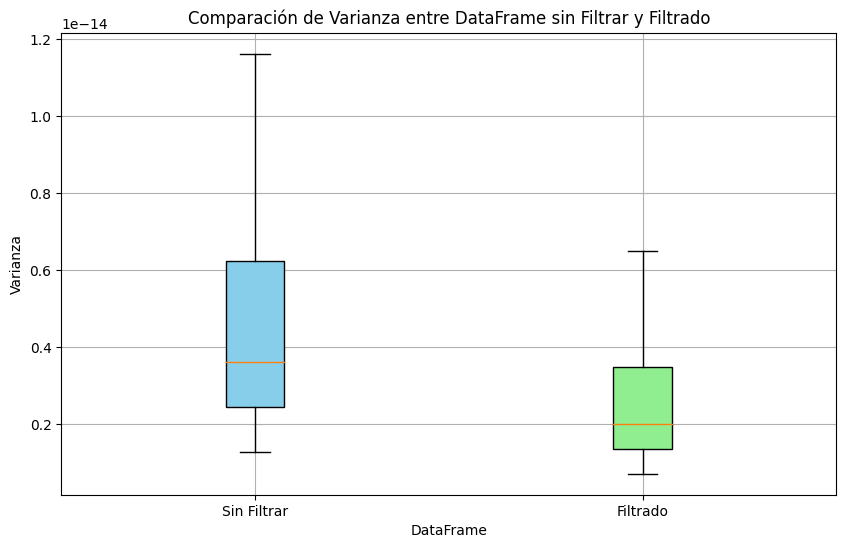

In [ ]:
import matplotlib.pyplot as plt

# Definir los canales para comparar (en este caso, todos los canales)
canales = ['Canal_1', 'Canal_2', 'Canal_3', 'Canal_4', 'Canal_5', 'Canal_6', 'Canal_7', 'Canal_8']

# Crear un gráfico de boxplot para comparar la varianza de cada canal
plt.figure(figsize=(10, 6))

# Lista para almacenar los datos de varianza de cada canal
varianza_crudo = []
varianza_filtrado = []

# Obtener y comparar la varianza de cada canal
for canal in canales:
    varianza_crudo.append(df_Crudo_transposed.loc[canal].var())
    varianza_filtrado.append(data_frame_transposed.loc[canal].var())

# Colores para los boxplots
colors = ['skyblue', 'lightgreen']

# Crear boxplots para los datos sin filtrar y filtrados
boxplot = plt.boxplot([varianza_crudo, varianza_filtrado], labels=['Sin Filtrar', 'Filtrado'], patch_artist=True)

# Personalizar los colores de los boxplots
for patch, color in zip(boxplot['boxes'], colors):
    patch.set_facecolor(color)

plt.xlabel('DataFrame')
plt.ylabel('Varianza')
plt.title('Comparación de Varianza entre DataFrame sin Filtrar y Filtrado')
plt.grid(True)
plt.show()


Como podemos ver al realizar un analizis de varianza entre los data frames totales filtrados y sin filtrar encontramos una varianza significativa por lo que podemos concluir que ambos grupos son diferentes y procedemos a analizar cada metrica :

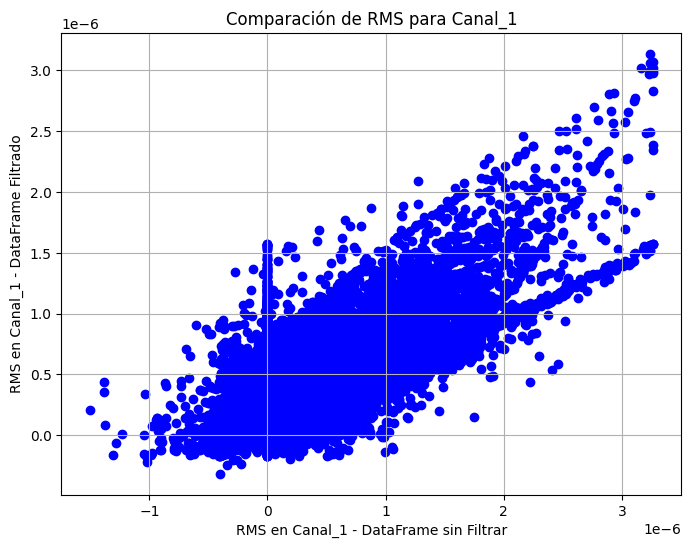

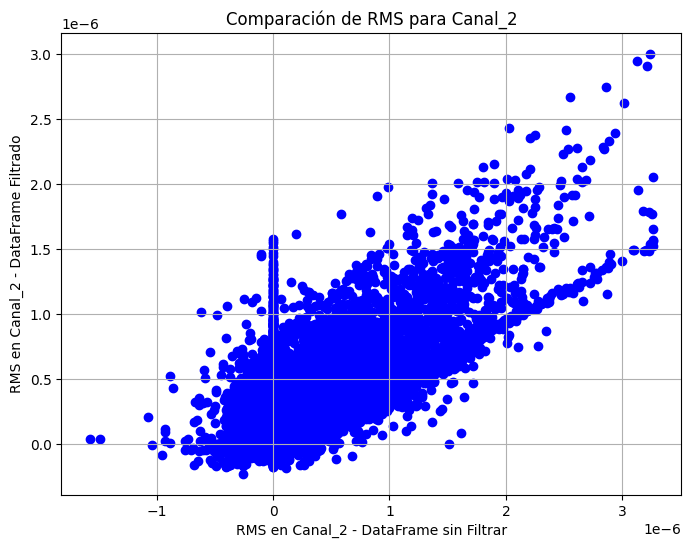

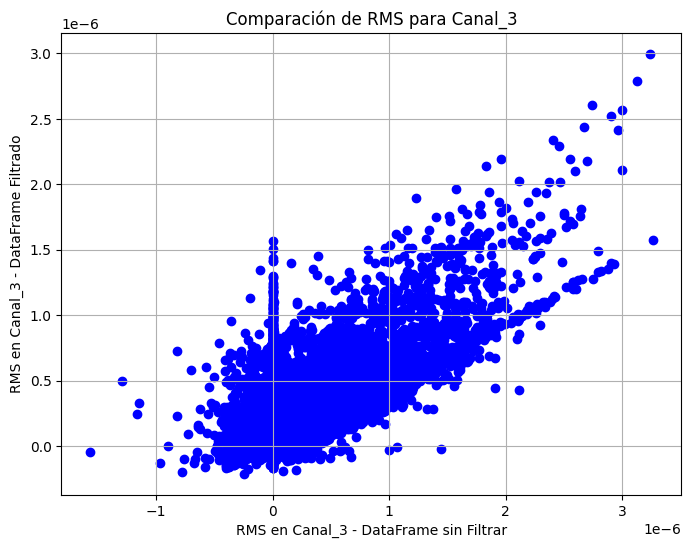

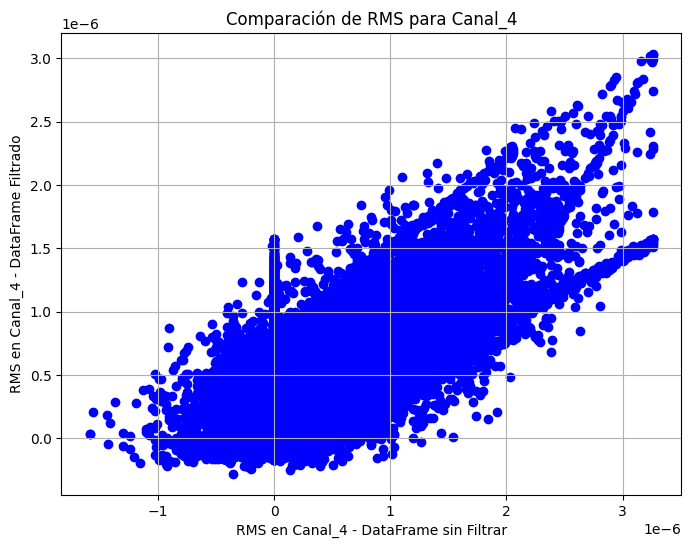

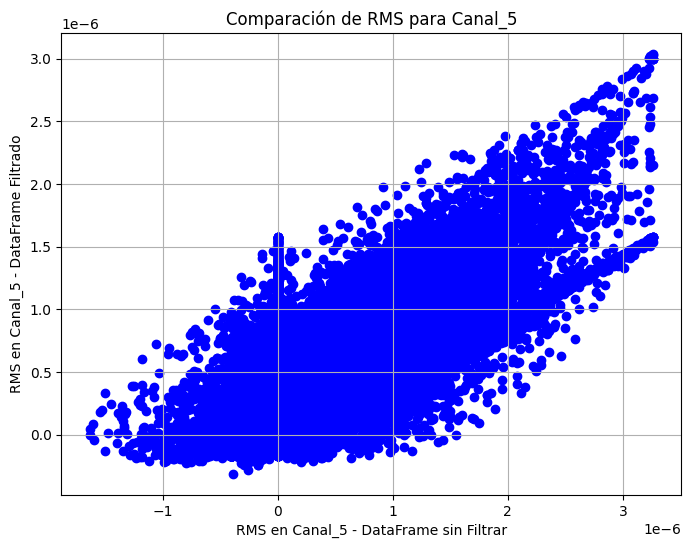

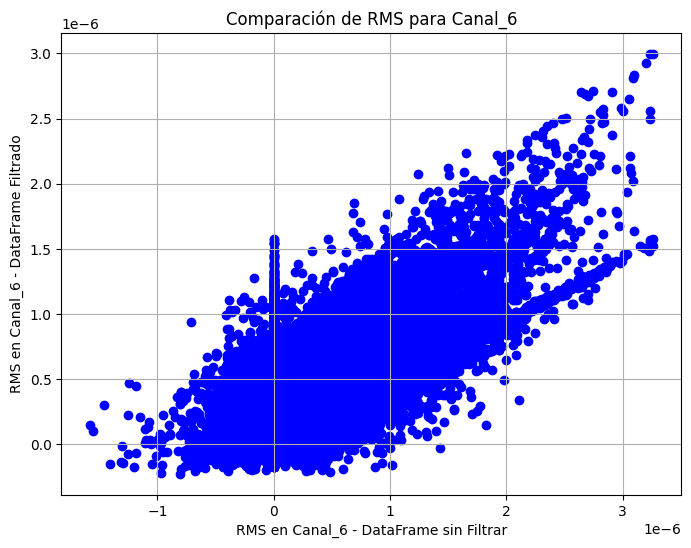

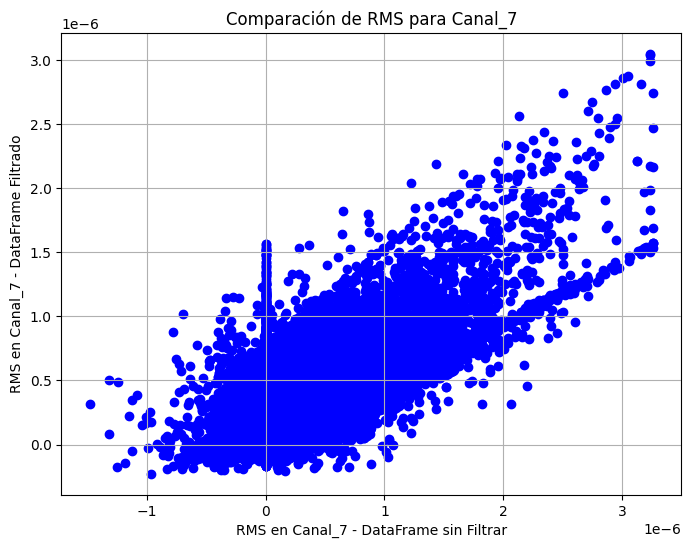

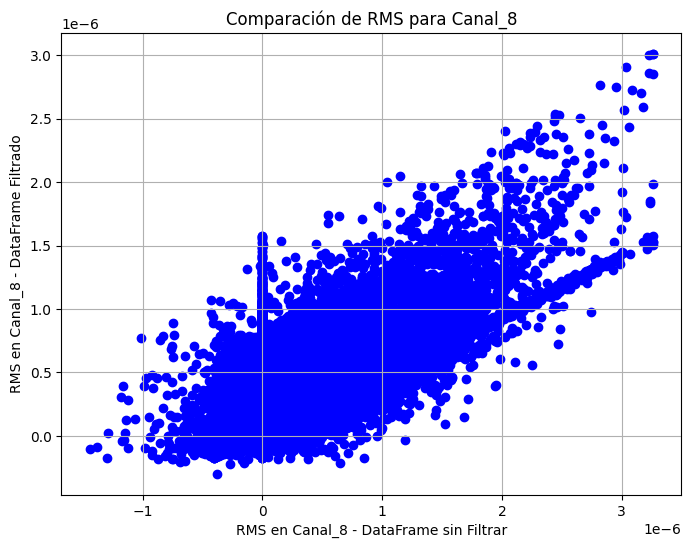

In [ ]:
import matplotlib.pyplot as plt

# Definir los canales para comparar (en este caso, todos los canales)
canales = ['Canal_1', 'Canal_2', 'Canal_3', 'Canal_4', 'Canal_5', 'Canal_6', 'Canal_7', 'Canal_8']

# Crear un gráfico para cada canal
for canal in canales:
    # Obtener los valores de RMS para el canal específico en cada DataFrame
    rms_df_crudo = df_Crudo_transposed.loc[canal]
    rms_df_filtrado = data_frame_transposed.loc[canal]

    # Graficar los valores de RMS para comparación
    plt.figure(figsize=(8, 6))
    plt.scatter(rms_df_crudo, rms_df_filtrado, color='blue')
    plt.xlabel(f'RMS en {canal} - DataFrame sin Filtrar')
    plt.ylabel(f'RMS en {canal} - DataFrame Filtrado')
    plt.title(f'Comparación de RMS para {canal}')
    plt.grid(True)
    plt.show()


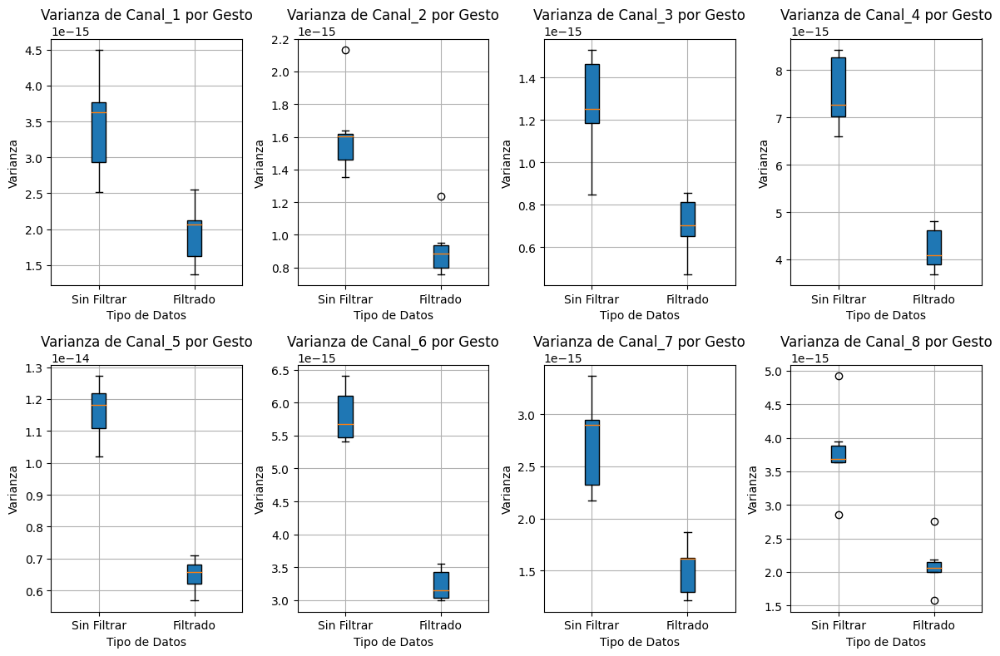

In [ ]:
import matplotlib.pyplot as plt

# Definir los canales para comparar (en este caso, todos los canales)
canales = ['Canal_1', 'Canal_2', 'Canal_3', 'Canal_4', 'Canal_5', 'Canal_6', 'Canal_7', 'Canal_8']

# Diccionario para almacenar los resultados de la varianza por clase para cada canal
varianza_por_clase = {}

# Iterar sobre los canales
for canal in canales:
    # Filtrar los datos del Canal por clase en df_Crudo_transposed
    crudo_data = df_Crudo_transposed.loc[canal]
    crudo_clases = df_Crudo_transposed.loc['Clase']

    # Filtrar los datos del Canal por clase en data_frame_transposed
    filtrado_data = data_frame_transposed.loc[canal]
    filtrado_clases = data_frame_transposed.loc['Clase']

    # Obtener las clases únicas
    clases = crudo_clases.unique()

    # Calcular la varianza por clase para los datos sin filtrar y filtrados
    varianza_por_clase[canal] = {'Crudo': {}, 'Filtrado': {}}
    for clase in clases:
        varianza_por_clase[canal]['Crudo'][clase] = crudo_data[crudo_clases == clase].var()
        varianza_por_clase[canal]['Filtrado'][clase] = filtrado_data[filtrado_clases == clase].var()

# Crear un box plot para comparar las varianzas de todos los canales
plt.figure(figsize=(12, 8))
for i, canal in enumerate(canales, start=1):
    varianza_sin_filtrar = list(varianza_por_clase[canal]['Crudo'].values())
    varianza_filtrada = list(varianza_por_clase[canal]['Filtrado'].values())

    plt.subplot(2, 4, i)
    plt.boxplot([varianza_sin_filtrar, varianza_filtrada], labels=['Sin Filtrar', 'Filtrado'], patch_artist=True)
    plt.xlabel('Tipo de Datos')
    plt.ylabel('Varianza')
    plt.title(f'Varianza de {canal} por Gesto')
    plt.grid(True)

plt.tight_layout()
plt.show()



Las gráficas muestran box plots que comparan la varianza de los datos sin filtrar y filtrados para cada canal de la señal EMG. Las cajas representan la distribución de la varianza para cada tipo de datos, con la línea central indicando la mediana, los bordes de la caja indicando los cuartiles Q1 y Q3, y los bigotes indicando los valores extremos.

# **Interpretación de los resultados**
Efecto del filtrado: En general, se observa que el filtrado reduce la varianza de los datos en todos los canales. Esto indica que el filtrado elimina parte del ruido de la señal, lo que resulta en una medida más precisa de la actividad muscular real.
La distribución de la varianza dentro de cada tipo de datos (sin filtrar y filtrado) también es variable. En algunos canales, la distribución es relativamente simétrica, mientras que en otros es más asimétrica. Esto sugiere que la variabilidad de la actividad muscular varía entre los diferentes canales y tipos de datos.


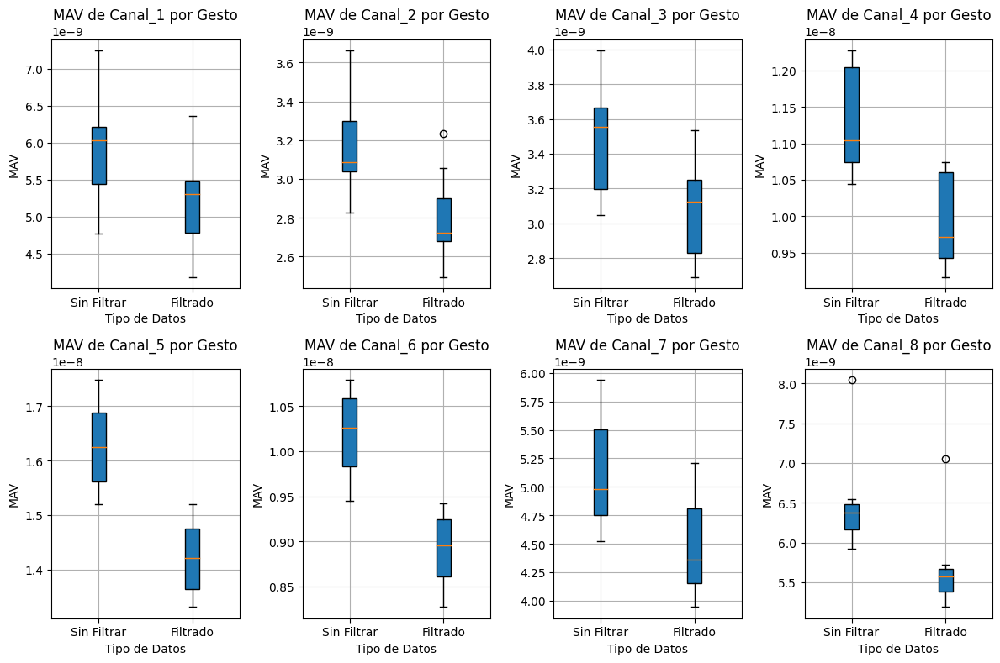

In [ ]:
import matplotlib.pyplot as plt

# Definir los canales para comparar (en este caso, todos los canales)
canales = ['Canal_1', 'Canal_2', 'Canal_3', 'Canal_4', 'Canal_5', 'Canal_6', 'Canal_7', 'Canal_8']

# Diccionario para almacenar los resultados de MAV por clase para cada canal
mav_por_clase = {}

# Iterar sobre los canales
for canal in canales:
    # Filtrar los datos del Canal por clase en df_Crudo_transposed
    crudo_data = df_Crudo_transposed.loc[canal]
    crudo_clases = df_Crudo_transposed.loc['Clase']

    # Filtrar los datos del Canal por clase en data_frame_transposed
    filtrado_data = data_frame_transposed.loc[canal]
    filtrado_clases = data_frame_transposed.loc['Clase']

    # Obtener las clases únicas
    clases = crudo_clases.unique()

    # Calcular el MAV por clase para los datos sin filtrar y filtrados
    mav_por_clase[canal] = {'Crudo': {}, 'Filtrado': {}}
    for clase in clases:
        mav_por_clase[canal]['Crudo'][clase] = crudo_data[crudo_clases == clase].abs().mean()
        mav_por_clase[canal]['Filtrado'][clase] = filtrado_data[filtrado_clases == clase].abs().mean()

# Crear un box plot para comparar los MAV de todos los canales
plt.figure(figsize=(12, 8))
for i, canal in enumerate(canales, start=1):
    mav_sin_filtrar = list(mav_por_clase[canal]['Crudo'].values())
    mav_filtrado = list(mav_por_clase[canal]['Filtrado'].values())

    plt.subplot(2, 4, i)
    plt.boxplot([mav_sin_filtrar, mav_filtrado], labels=['Sin Filtrar', 'Filtrado'], patch_artist=True)
    plt.xlabel('Tipo de Datos')
    plt.ylabel('MAV')
    plt.title(f'MAV de {canal} por Gesto')
    plt.grid(True)

plt.tight_layout()
plt.show()


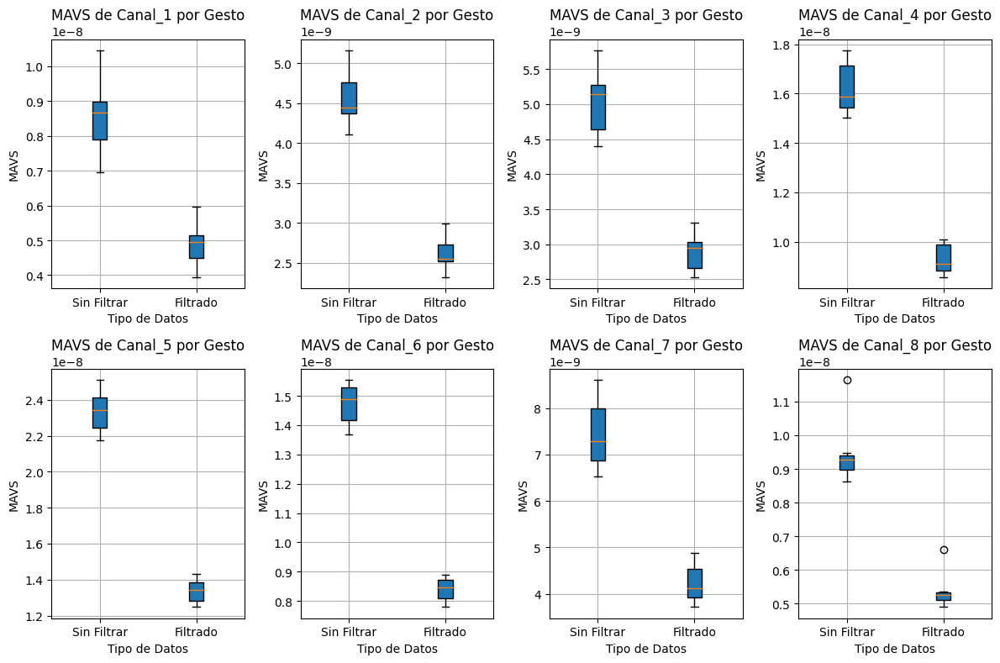

In [ ]:
import matplotlib.pyplot as plt

# Definir los canales para comparar (en este caso, todos los canales)
canales = ['Canal_1', 'Canal_2', 'Canal_3', 'Canal_4', 'Canal_5', 'Canal_6', 'Canal_7', 'Canal_8']

# Diccionario para almacenar los resultados de MAVS por clase para cada canal
mavs_por_clase = {}

# Iterar sobre los canales
for canal in canales:
    # Filtrar los datos del Canal por clase en df_Crudo_transposed
    crudo_data = df_Crudo_transposed.loc[canal]
    crudo_clases = df_Crudo_transposed.loc['Clase']

    # Filtrar los datos del Canal por clase en data_frame_transposed
    filtrado_data = data_frame_transposed.loc[canal]
    filtrado_clases = data_frame_transposed.loc['Clase']

    # Obtener las clases únicas
    clases = crudo_clases.unique()

    # Calcular el MAVS por clase para los datos sin filtrar y filtrados
    mavs_por_clase[canal] = {'Crudo': {}, 'Filtrado': {}}
    for clase in clases:
        crudo_mavs = abs(crudo_data[crudo_clases == clase].diff()).mean()
        filtrado_mavs = abs(filtrado_data[filtrado_clases == clase].diff()).mean()
        mavs_por_clase[canal]['Crudo'][clase] = crudo_mavs
        mavs_por_clase[canal]['Filtrado'][clase] = filtrado_mavs

# Crear un box plot para comparar los MAVS de todos los canales
plt.figure(figsize=(12, 8))
for i, canal in enumerate(canales, start=1):
    mavs_sin_filtrar = list(mavs_por_clase[canal]['Crudo'].values())
    mavs_filtrado = list(mavs_por_clase[canal]['Filtrado'].values())

    plt.subplot(2, 4, i)
    plt.boxplot([mavs_sin_filtrar, mavs_filtrado], labels=['Sin Filtrar', 'Filtrado'], patch_artist=True)
    plt.xlabel('Tipo de Datos')
    plt.ylabel('MAVS')
    plt.title(f'MAVS de {canal} por Gesto')
    plt.grid(True)

plt.tight_layout()
plt.show()



# **Interpretación de los resultados**
Variación del MAV y MAVS entre canales: Se observa que el MAV varía considerablemente entre los diferentes canales. Algunos canales, como el Canal_1 y el Canal_2, presentan un MAV relativamente bajo, mientras que otros, como el Canal_7 y el Canal_8, presentan un MAV mucho mayor.
de manera similar, En general, se observa que el filtrado reduce el MAV de los datos en todos los canales. Esto indica que el filtrado elimina parte del ruido de la señal, lo que resulta en una medida más precisa de la actividad muscular real.

Variabilidad dentro de cada tipo de datos: La distribución del MAV dentro de cada tipo de datos (sin filtrar y filtrado) también es variable. En algunos canales, la distribución es relativamente simétrica, mientras que en otros es más asimétrica. Esto sugiere que la variabilidad de la actividad muscular varía entre los diferentes canales y tipos de datos.

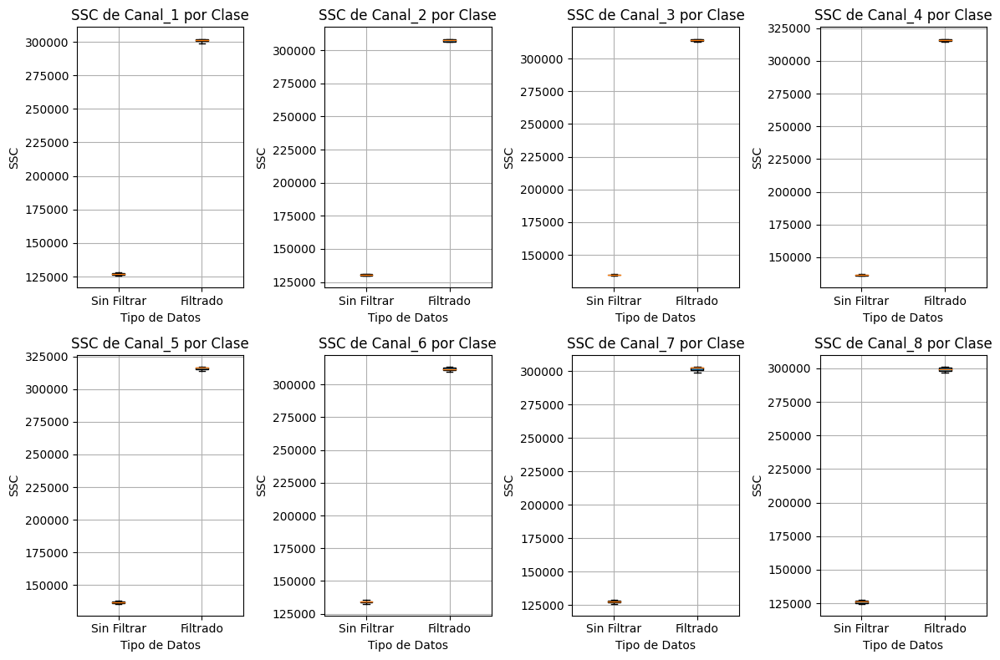

In [ ]:
import matplotlib.pyplot as plt

# Definir los canales para comparar (en este caso, todos los canales)
canales = ['Canal_1', 'Canal_2', 'Canal_3', 'Canal_4', 'Canal_5', 'Canal_6', 'Canal_7', 'Canal_8']

# Diccionario para almacenar los resultados de SSC por clase para cada canal
ssc_por_clase = {}

# Iterar sobre los canales
for canal in canales:
    # Filtrar los datos del Canal por clase en df_Crudo_transposed
    crudo_data = df_Crudo_transposed.loc[canal]
    crudo_clases = df_Crudo_transposed.loc['Clase']

    # Filtrar los datos del Canal por clase en data_frame_transposed
    filtrado_data = data_frame_transposed.loc[canal]
    filtrado_clases = data_frame_transposed.loc['Clase']

    # Obtener las clases únicas
    clases = crudo_clases.unique()

    # Calcular el SSC por clase para los datos sin filtrar y filtrados
    ssc_por_clase[canal] = {'Crudo': {}, 'Filtrado': {}}
    for clase in clases:
        crudo_ssc = sum(crudo_data[crudo_clases == clase].diff().fillna(0) != 0)
        filtrado_ssc = sum(filtrado_data[filtrado_clases == clase].diff().fillna(0) != 0)
        ssc_por_clase[canal]['Crudo'][clase] = crudo_ssc
        ssc_por_clase[canal]['Filtrado'][clase] = filtrado_ssc

# Crear un box plot para comparar los SSC de todos los canales
plt.figure(figsize=(12, 8))
for i, canal in enumerate(canales, start=1):
    ssc_sin_filtrar = list(ssc_por_clase[canal]['Crudo'].values())
    ssc_filtrado = list(ssc_por_clase[canal]['Filtrado'].values())

    plt.subplot(2, 4, i)
    plt.boxplot([ssc_sin_filtrar, ssc_filtrado], labels=['Sin Filtrar', 'Filtrado'], patch_artist=True)
    plt.xlabel('Tipo de Datos')
    plt.ylabel('SSC')
    plt.title(f'SSC de {canal} por Clase')
    plt.grid(True)

plt.tight_layout()
plt.show()


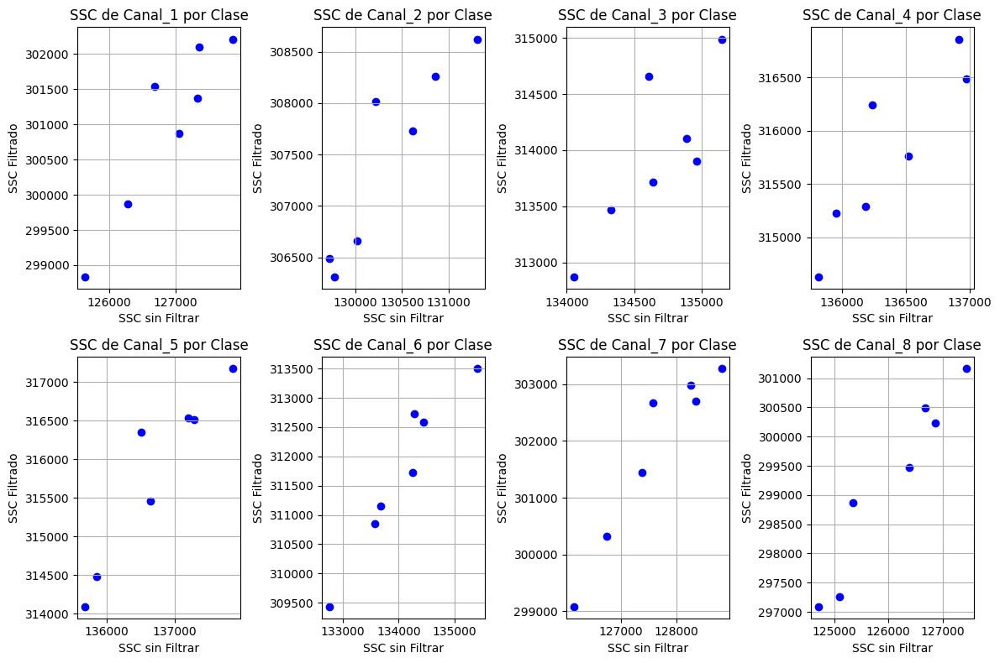

In [ ]:
import matplotlib.pyplot as plt

# Definir los canales para comparar (en este caso, todos los canales)
canales = ['Canal_1', 'Canal_2', 'Canal_3', 'Canal_4', 'Canal_5', 'Canal_6', 'Canal_7', 'Canal_8']

# Diccionario para almacenar los resultados de SSC por clase para cada canal
ssc_por_clase = {}

# Iterar sobre los canales
for canal in canales:
    # Filtrar los datos del Canal por clase en df_Crudo_transposed
    crudo_data = df_Crudo_transposed.loc[canal]
    crudo_clases = df_Crudo_transposed.loc['Clase']

    # Filtrar los datos del Canal por clase en data_frame_transposed
    filtrado_data = data_frame_transposed.loc[canal]
    filtrado_clases = data_frame_transposed.loc['Clase']

    # Obtener las clases únicas
    clases = crudo_clases.unique()

    # Calcular el SSC por clase para los datos sin filtrar y filtrados
    ssc_por_clase[canal] = {'Crudo': {}, 'Filtrado': {}}
    for clase in clases:
        crudo_ssc = sum(crudo_data[crudo_clases == clase].diff().fillna(0) != 0)
        filtrado_ssc = sum(filtrado_data[filtrado_clases == clase].diff().fillna(0) != 0)
        ssc_por_clase[canal]['Crudo'][clase] = crudo_ssc
        ssc_por_clase[canal]['Filtrado'][clase] = filtrado_ssc

# Crear un diagrama de dispersión de puntos para comparar los SSC de todos los canales
plt.figure(figsize=(12, 8))
for i, canal in enumerate(canales, start=1):
    ssc_sin_filtrar = list(ssc_por_clase[canal]['Crudo'].values())
    ssc_filtrado = list(ssc_por_clase[canal]['Filtrado'].values())

    plt.subplot(2, 4, i)
    plt.scatter(ssc_sin_filtrar, ssc_filtrado, color='blue')
    plt.xlabel('SSC sin Filtrar')
    plt.ylabel('SSC Filtrado')
    plt.title(f'SSC de {canal} por Clase')
    plt.grid(True)

plt.tight_layout()
plt.show()


Descripción de las gráficas

Las gráficas muestran diagramas de dispersión que comparan el SSC de los datos sin filtrar y filtrados para cada canal de la señal EMG. Cada punto en el diagrama representa el SSC de una clase para un canal específico. La distribución de los puntos permite observar si existe una relación entre el SSC sin filtrar y el SSC filtrado para cada clase y canal.

Interpretación de los resultados

Relación entre SSC sin filtrar y filtrado: En general, se observa que existe una correlación positiva entre el SSC sin filtrar y el SSC filtrado para la mayoría de los canales. Esto significa que a medida que aumenta el SSC sin filtrar, también aumenta el SSC filtrado.
El filtrado reduce el SSC en general para todos los canales. Sin embargo, la magnitud de la reducción varía entre los canales. En algunos canales, como el Canal_1 y el Canal_2, la reducción del SSC es relativamente pequeña

Distribución del SSC por clase: La distribución del SSC dentro de cada clase (sin filtrar y filtrado) también es variable. En algunos canales, la distribución es relativamente simétrica, mientras que en otros es más asimétrica. Esto sugiere que la variabilidad del SSC varía entre los diferentes canales y clases.

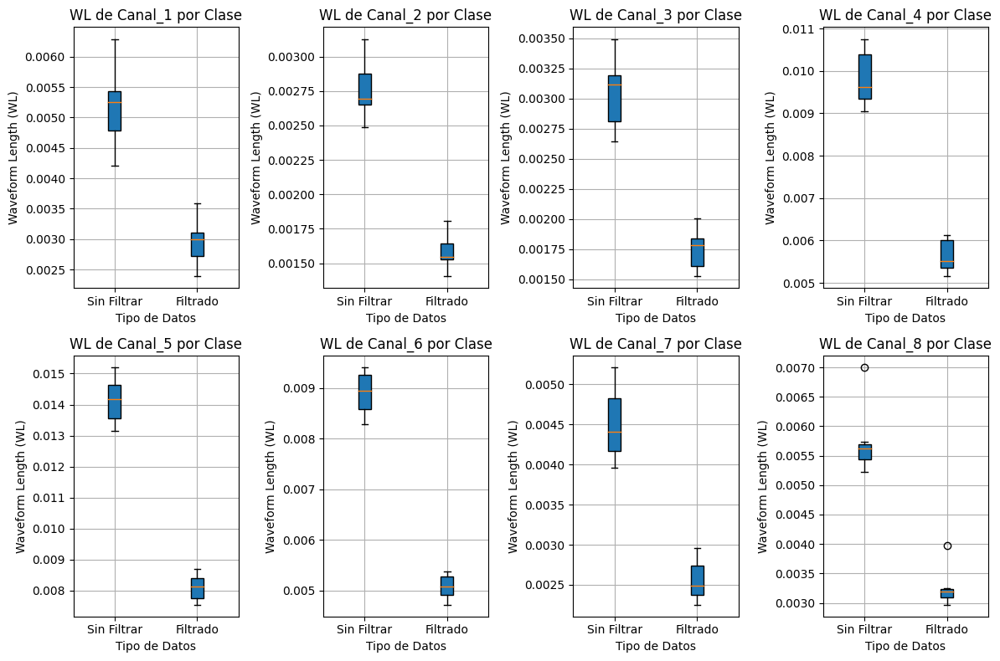

In [ ]:
import matplotlib.pyplot as plt

# Definir los canales para comparar (en este caso, todos los canales)
canales = ['Canal_1', 'Canal_2', 'Canal_3', 'Canal_4', 'Canal_5', 'Canal_6', 'Canal_7', 'Canal_8']

# Diccionario para almacenar los resultados de WL por clase para cada canal
wl_por_clase = {}

# Iterar sobre los canales
for canal in canales:
    # Filtrar los datos del Canal por clase en df_Crudo_transposed
    crudo_data = df_Crudo_transposed.loc[canal]
    crudo_clases = df_Crudo_transposed.loc['Clase']

    # Filtrar los datos del Canal por clase en data_frame_transposed
    filtrado_data = data_frame_transposed.loc[canal]
    filtrado_clases = data_frame_transposed.loc['Clase']

    # Obtener las clases únicas
    clases = crudo_clases.unique()

    # Calcular el WL por clase para los datos sin filtrar y filtrados
    wl_por_clase[canal] = {'Crudo': {}, 'Filtrado': {}}
    for clase in clases:
        crudo_wl = sum(abs(crudo_data[crudo_clases == clase].diff().fillna(0)))
        filtrado_wl = sum(abs(filtrado_data[filtrado_clases == clase].diff().fillna(0)))
        wl_por_clase[canal]['Crudo'][clase] = crudo_wl
        wl_por_clase[canal]['Filtrado'][clase] = filtrado_wl

# Crear un box plot para comparar los WL de todos los canales
plt.figure(figsize=(12, 8))
for i, canal in enumerate(canales, start=1):
    wl_sin_filtrar = list(wl_por_clase[canal]['Crudo'].values())
    wl_filtrado = list(wl_por_clase[canal]['Filtrado'].values())

    plt.subplot(2, 4, i)
    plt.boxplot([wl_sin_filtrar, wl_filtrado], labels=['Sin Filtrar', 'Filtrado'], patch_artist=True)
    plt.xlabel('Tipo de Datos')
    plt.ylabel('Waveform Length (WL)')
    plt.title(f'WL de {canal} por Clase')
    plt.grid(True)

plt.tight_layout()
plt.show()


# **Interpretación de los resultados**
Variación del WL entre canales: Se observa que el WL varía considerablemente entre los diferentes canales.

Efecto del filtrado: En general, se observa que el filtrado reduce el WL de los datos en todos los canales. Esto indica que el filtrado elimina parte del ruido de la señal, lo que resulta en una medida más precisa de la actividad muscular real.

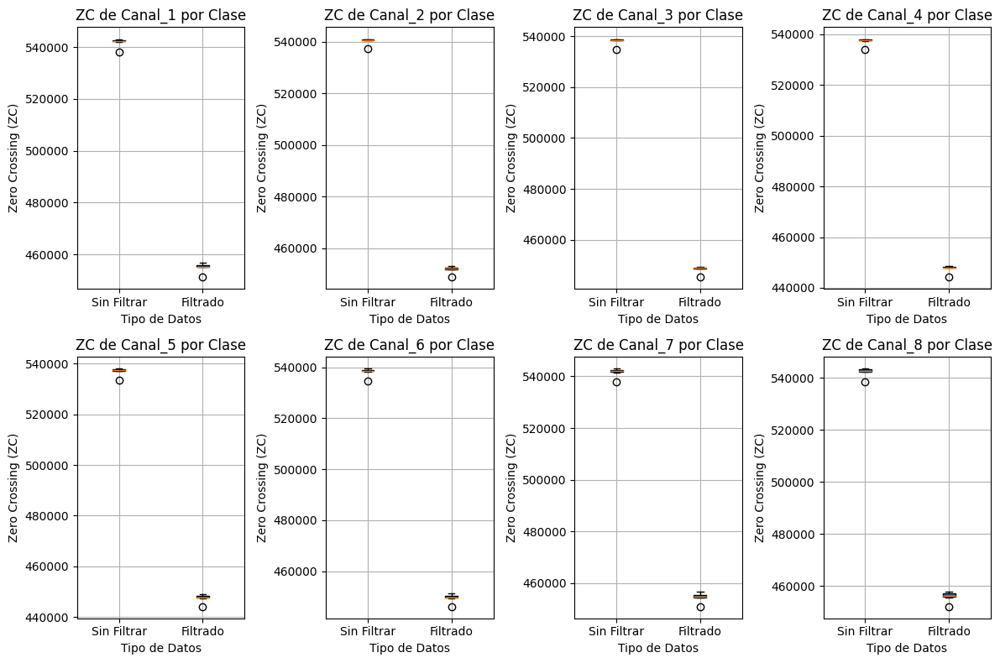

In [ ]:
import matplotlib.pyplot as plt

# Definir los canales para comparar (en este caso, todos los canales)
canales = ['Canal_1', 'Canal_2', 'Canal_3', 'Canal_4', 'Canal_5', 'Canal_6', 'Canal_7', 'Canal_8']

# Diccionario para almacenar los resultados de ZC por clase para cada canal
zc_por_clase = {}

# Iterar sobre los canales
for canal in canales:
    # Filtrar los datos del Canal por clase en df_Crudo_transposed
    crudo_data = df_Crudo_transposed.loc[canal]
    crudo_clases = df_Crudo_transposed.loc['Clase']

    # Filtrar los datos del Canal por clase en data_frame_transposed
    filtrado_data = data_frame_transposed.loc[canal]
    filtrado_clases = data_frame_transposed.loc['Clase']

    # Obtener las clases únicas
    clases = crudo_clases.unique()

    # Calcular el ZC por clase para los datos sin filtrar y filtrados
    zc_por_clase[canal] = {'Crudo': {}, 'Filtrado': {}}
    for clase in clases:
        crudo_zc = len(crudo_data[crudo_clases == clase]) - len(crudo_data[crudo_clases == clase].fillna(0).diff().fillna(0).where(lambda x: x < 0).dropna())
        filtrado_zc = len(filtrado_data[filtrado_clases == clase]) - len(filtrado_data[filtrado_clases == clase].fillna(0).diff().fillna(0).where(lambda x: x < 0).dropna())
        zc_por_clase[canal]['Crudo'][clase] = crudo_zc
        zc_por_clase[canal]['Filtrado'][clase] = filtrado_zc

# Crear un box plot para comparar los ZC de todos los canales
plt.figure(figsize=(12, 8))
for i, canal in enumerate(canales, start=1):
    zc_sin_filtrar = list(zc_por_clase[canal]['Crudo'].values())
    zc_filtrado = list(zc_por_clase[canal]['Filtrado'].values())

    plt.subplot(2, 4, i)
    plt.boxplot([zc_sin_filtrar, zc_filtrado], labels=['Sin Filtrar', 'Filtrado'], patch_artist=True)
    plt.xlabel('Tipo de Datos')
    plt.ylabel('Zero Crossing (ZC)')
    plt.title(f'ZC de {canal} por Clase')
    plt.grid(True)

plt.tight_layout()
plt.show()


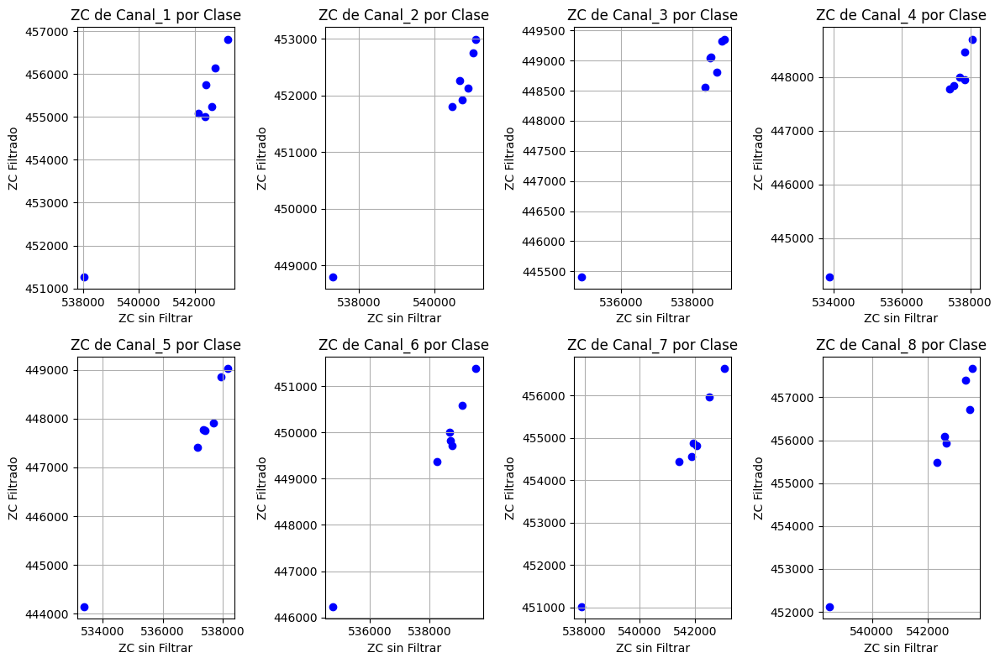

In [ ]:
import matplotlib.pyplot as plt

# Definir los canales para comparar (en este caso, todos los canales)
canales = ['Canal_1', 'Canal_2', 'Canal_3', 'Canal_4', 'Canal_5', 'Canal_6', 'Canal_7', 'Canal_8']

# Diccionario para almacenar los resultados de ZC por clase para cada canal
zc_por_clase = {}

# Iterar sobre los canales
for canal in canales:
    # Filtrar los datos del Canal por clase en df_Crudo_transposed
    crudo_data = df_Crudo_transposed.loc[canal]
    crudo_clases = df_Crudo_transposed.loc['Clase']

    # Filtrar los datos del Canal por clase en data_frame_transposed
    filtrado_data = data_frame_transposed.loc[canal]
    filtrado_clases = data_frame_transposed.loc['Clase']

    # Obtener las clases únicas
    clases = crudo_clases.unique()

    # Calcular el ZC por clase para los datos sin filtrar y filtrados
    zc_por_clase[canal] = {'Crudo': {}, 'Filtrado': {}}
    for clase in clases:
        crudo_zc = len(crudo_data[crudo_clases == clase]) - len(crudo_data[crudo_clases == clase].fillna(0).diff().fillna(0).where(lambda x: x < 0).dropna())
        filtrado_zc = len(filtrado_data[filtrado_clases == clase]) - len(filtrado_data[filtrado_clases == clase].fillna(0).diff().fillna(0).where(lambda x: x < 0).dropna())
        zc_por_clase[canal]['Crudo'][clase] = crudo_zc
        zc_por_clase[canal]['Filtrado'][clase] = filtrado_zc

# Crear un diagrama de dispersión de puntos para comparar los ZC de todos los canales
plt.figure(figsize=(12, 8))
for i, canal in enumerate(canales, start=1):
    zc_sin_filtrar = list(zc_por_clase[canal]['Crudo'].values())
    zc_filtrado = list(zc_por_clase[canal]['Filtrado'].values())

    plt.subplot(2, 4, i)
    plt.scatter(zc_sin_filtrar, zc_filtrado, color='blue')
    plt.xlabel('ZC sin Filtrar')
    plt.ylabel('ZC Filtrado')
    plt.title(f'ZC de {canal} por Clase')
    plt.grid(True)

plt.tight_layout()
plt.show()


Descripción de las gráficas

Las gráficas muestran diagramas de dispersión que comparan el ZC de los datos sin filtrar y filtrados para cada canal de la señal EMG. Cada punto en el diagrama representa el ZC de una clase para un canal específico. La distribución de los puntos permite observar si existe una relación entre el ZC sin filtrar y el ZC filtrado para cada clase y canal.

Interpretación de los resultados

Relación entre ZC sin filtrar y filtrado: En general, se observa que existe una correlación positiva entre el ZC sin filtrar y el ZC filtrado para la mayoría de los canales. Esto significa que a medida que aumenta el ZC sin filtrar, también aumenta el ZC filtrado.

Efecto del filtrado: El filtrado reduce el ZC en general para todos los canales. Sin embargo, la magnitud de la reducción varía entre los canales. casi siempre, la reducción del ZC es relativamente pequeña

Distribución del ZC por clase: La distribución del ZC dentro de cada clase (sin filtrar y filtrado) también es variable. En algunos canales, la distribución es relativamente simétrica, mientras que en otros es más asimétrica. Esto sugiere que la variabilidad del ZC varía entre los diferentes canales y clases.

# **d. (10%) Analizar y discutir los resultados del punto anterior de manera que para los puntos siguientes se usen, debidamente sustentado, los índices obtenidos con la señal filtrada o la señal sin filtrar (10%).**

La observación de las diferencias significativas entre los datos sin filtrar y los datos filtrados, como se evidencia en las diferentes visualizaciones y análisis estadísticos realizados, sugiere claramente que la aplicación del filtro tiene un impacto notable en la representación de la señal. Esto es especialmente evidente en métricas como Zero Crossing (ZC), Mean Absolute Value Slope (MAVS), Slope Sign Changes (SSC), y en algunos casos de Mean Absolute Value (MAV) y varianza.

Los box plots muestran que en varios casos los resultados obtenidos después de aplicar el filtro no están contenidos dentro del rango de los datos sin filtrar. Esto sugiere una transformación sustancial de la señal después de aplicar el filtro, lo que puede indicar una reducción significativa del ruido.

La decisión de utilizar los datos filtrados para el entrenamiento del modelo se basa en la creencia de que al reducir el ruido en la señal, se puede mejorar la capacidad predictiva del modelo. Aunque los datos sin filtrar pueden contener información importante, la presencia de ruido puede dificultar la extracción de características significativas para la clasificación de gestos.


# **e. (30%) Código y análisis de resultados, donde se discutan por los menos tres diferentes arquitecturas de red (10%) y las matrices de confusión obtenidas (10%), validación cruzada (10%), de una red neuronal que permita la clasificación de los diferentes gestos (Etiquetas con los datos del primer proyecto).**

In [ ]:
from google.colab import drive

# Montar Google Drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


La implementación del operador TKEO y del filtro diseñado se aplicó a todas las columnas de mis datos, excepto a la primera y la última. La primera columna corresponde al tiempo, mientras que la última se refiere a la clase.

In [ ]:
import os
import pandas as pd
import numpy as np
from scipy.signal import firwin, convolve, filtfilt

# Función para aplicar el operador TKEO a una serie de datos
def apply_tkeo(signal):
    tkeo_signal = np.zeros_like(signal)
    tkeo_signal[1:-1] = signal[1:-1]**2 - signal[:-2] * signal[2:]
    return tkeo_signal

# Definir los parámetros del filtro pasa altas
order_highpass = 2
cutoff_freq_highpass = 10  # Frecuencia de corte del filtro pasa altas en Hz

# Definir los parámetros del filtro pasa bajas
order_lowpass = 3
cutoff_freq_lowpass = 40  # Frecuencia de corte del filtro pasa bajas en Hz

# Frecuencia de muestreo de las señales EMG
sampling_freq = 200  # Hz

# Diseñar los filtros FIR utilizando la ventana de Hamming
fir_coefficients_highpass = firwin(order_highpass + 1, cutoff_freq_highpass, fs=sampling_freq, pass_zero=False, window='hamming')
fir_coefficients_lowpass = firwin(order_lowpass + 1, cutoff_freq_lowpass, fs=sampling_freq, window='hamming')

# Combinar los filtros pasa altas y pasa bajas para obtener el filtro pasa bandas
fir_coefficients_bandpass = convolve(fir_coefficients_highpass, fir_coefficients_lowpass, mode='full')

# Ruta de la carpeta que contiene los datos
ruta_base = '/content/drive/MyDrive/PROYECTO FINAL/EMG_data_for_gestures-master'

# Lista para almacenar los datos de los archivos TXT
datos = []

# Recorrer las subcarpetas numeradas del 01 al 36
for i in range(1, 37):
    # Ruta de la subcarpeta actual
    ruta_subcarpeta = os.path.join(ruta_base, f'{i:02}')

    # Obtener la lista de archivos TXT en la subcarpeta
    archivos_txt = [archivo for archivo in os.listdir(ruta_subcarpeta) if archivo.endswith('.txt')]

    # Recorrer los archivos TXT en la subcarpeta
    for archivo in archivos_txt:
        # Leer el archivo TXT y cargar los datos en un DataFrame
        df = pd.read_csv(os.path.join(ruta_subcarpeta, archivo), delimiter='\t')

        # Aplicar TKEO a las columnas de canales (excluyendo la primera y la última)
        channels = ['channel1', 'channel2', 'channel3', 'channel4', 'channel5', 'channel6', 'channel7', 'channel8']
        for channel in channels:
            df[channel] = apply_tkeo(df[channel].values)

            # Aplicar el filtro pasa bandas a la señal EMG (excluyendo la primera y la última columna)
            if channel != 'time' and channel != 'class':
                df[channel] = filtfilt(fir_coefficients_bandpass, [1.0], df[channel])

        # Agregar los datos al listado
        datos.append(df)

# Concatenar todos los DataFrames en uno solo
df_final = pd.concat(datos, ignore_index=True)

# Mostrar las primeras filas del DataFrame final



In [ ]:
df_final.head()

,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,class
0,2,2.966117e-28,-2.019484e-28,-2.322407e-27,2.524355e-29,2.776790e-28,-2.761013e-28,-1.135960e-28,-5.364254e-28,0.0
1,6,-3.445728e-11,-5.094183e-11,-1.504875e-10,-5.672266e-11,-3.049379e-11,2.325609e-11,7.780487e-11,1.973595e-10,0.0
2,7,5.448388e-11,3.104866e-10,9.788411e-10,2.587095e-10,9.703458e-11,4.260854e-11,2.209596e-10,2.518085e-10,0.0
3,8,2.090782e-10,7.084903e-10,2.447480e-09,7.902192e-10,2.477263e-10,2.328349e-11,2.402806e-10,4.704022e-11,0.0
4,9,1.356847e-10,3.104907e-10,1.466046e-09,6.241081e-10,9.703662e-11,2.008146e-12,9.915843e-11,4.880247e-11,0.0


In [ ]:
# Verificar el número de valores únicos en la columna "class"
num_valores_unicos = df_final['class'].nunique()

# Mostrar el número de valores únicos
print("Número de valores únicos en la columna 'class':", num_valores_unicos)


Número de valores únicos en la columna 'class': 8


Según la base de datos, se identificaron los siguientes gestos:

1. Mano en reposo
2. Mano cerrada en un puño
3. Flexión de muñeca
4. Extensión de muñeca
5. Desviaciones radiales
6. Desviaciones cubitales
7. Palma extendida (este gesto no fue realizado por todos los sujetos)

El '0' representó datos no marcados, por lo tanto, se eliminaron todos los registros que contenían '0' para evitar introducir ruido en el modelo.

In [ ]:
# Eliminar filas donde el valor de la columna "class" sea igual a 0
df_final = df_final.loc[df_final['class'] != 0]

# Mostrar las primeras filas del DataFrame después de eliminar los datos
print(df_final.head())


     time  channel1  channel2  channel3  channel4  channel5  channel6  \
816   880       0.0       0.0       0.0       0.0       0.0       0.0   
817   881       0.0       0.0       0.0       0.0       0.0       0.0   
818   882       0.0       0.0       0.0       0.0       0.0       0.0   
819   883       0.0       0.0       0.0       0.0       0.0       0.0   
820   884       0.0       0.0       0.0       0.0       0.0       0.0   

     channel7  channel8  class  
816       0.0       0.0    1.0  
817       0.0       0.0    1.0  
818       0.0       0.0    1.0  
819       0.0       0.0    1.0  
820       0.0       0.0    1.0  


Se verifica la cantidad de datos 'unique' que tenemos en nuestra columna class para verificar que tenemos los 7 gestos.

In [ ]:
# Contar el número de valores únicos en la columna 'class'
num_valores_unicos = df_final['class'].nunique()

print("Número de valores únicos en la columna 'class':", num_valores_unicos)


Número de valores únicos en la columna 'class': 7


Una vez manipulados los datos, se verificó que ahora se tenía exactamente la cantidad de gestos representados como sigue:

1. Mano en reposo
2. Mano cerrada en un puño
3. Flexión de muñeca
4. Extensión de muñeca
5. Desviaciones radiales
6. Desviaciones cubitales
7. *Palma extendida* (este gesto no fue realizado por todos los sujetos).

In [ ]:
# Contar la cantidad de datos por clase
conteo_por_clase = df_final['class'].value_counts()

# Mostrar el conteo por clase
print(conteo_por_clase)


class
6.0    253009
5.0    251733
4.0    251570
1.0    250055
3.0    249494
2.0    243193
7.0     13696
Name: count, dtype: int64


El tiempo no es relevante para nuestro estudio, ya que no forma parte de las variables significativas. No es una variable target ni proporciona información útil al modelo; por lo tanto, hemos decidido eliminarla para evitar introducir ruido.

In [ ]:
# Eliminar la columna "time" del DataFrame
df_final = df_final.drop(columns=['time'])

# Mostrar las primeras filas del DataFrame después de eliminar la columna "time"
print(df_final.head())


     channel1  channel2  channel3  channel4  channel5  channel6  channel7  \
816       0.0       0.0       0.0       0.0       0.0       0.0       0.0   
817       0.0       0.0       0.0       0.0       0.0       0.0       0.0   
818       0.0       0.0       0.0       0.0       0.0       0.0       0.0   
819       0.0       0.0       0.0       0.0       0.0       0.0       0.0   
820       0.0       0.0       0.0       0.0       0.0       0.0       0.0   

     channel8  class  
816       0.0    1.0  
817       0.0    1.0  
818       0.0    1.0  
819       0.0    1.0  
820       0.0    1.0  


Se verificó que no hubiera valores NaN y se realizó un nuevo conteo por clase.

In [ ]:
# Verificar si hay valores NaN en alguna columna
nan_en_columnas = df_final.isna().any()

# Mostrar qué columnas tienen valores NaN
print(nan_en_columnas)


channel1    False
channel2    False
channel3    False
channel4    False
channel5    False
channel6    False
channel7    False
channel8    False
class        True
dtype: bool


In [ ]:
df_final.dropna(subset=['class'], inplace=True)


In [ ]:
# Verificar si hay valores NaN en alguna columna
nan_en_columnas = df_final.isna().any()

# Mostrar qué columnas tienen valores NaN
print(nan_en_columnas)


channel1    False
channel2    False
channel3    False
channel4    False
channel5    False
channel6    False
channel7    False
channel8    False
class       False
dtype: bool


Una vez eliminados los datos NaN, se procedió a realizar nuevamente un conteo por clase para verificar que nuestra base de datos no se haya alterado significativamente.

In [ ]:
# Contar la cantidad de datos por clase
conteo_por_clase = df_final['class'].value_counts()

# Mostrar el conteo por clase
print(conteo_por_clase)

class
6.0    253009
5.0    251733
4.0    251570
1.0    250055
3.0    249494
2.0    243193
7.0     13696
Name: count, dtype: int64


Notamos que tenemos la misma cantidad de datos por clase por lo que concluimos que al eliminar los datos NaN y el tiempo no modificamos nuestra señal de interes. continuamos por lo tanto con el proceso aplicando estadistica descriptiva

In [ ]:
# Imprimir el tamaño del DataFrame (número de filas y columnas)
print("Tamaño del DataFrame:")
df_final.shape


Tamaño del DataFrame:


(1512750, 9)

In [ ]:
# Mostrar una descripción estadística del DataFrame
print("Descripción del DataFrame:")
df_final.describe()

Descripción del DataFrame:


,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,class
count,1.512750e+06,1.512750e+06,1.512750e+06,1.512750e+06,1.512750e+06,1.512750e+06,1.512750e+06,1.512750e+06,1.512750e+06
mean,6.548379e-09,3.378382e-09,3.419173e-09,1.249613e-08,1.757420e-08,1.107029e-08,5.498490e-09,7.186566e-09,3.545724e+00
std,4.241056e-08,2.876246e-08,2.393968e-08,6.455310e-08,7.949317e-08,5.559377e-08,3.729935e-08,4.460065e-08,1.733837e+00
min,-1.383868e-07,-7.781107e-08,-7.755685e-08,-1.150957e-07,-1.094223e-07,-1.293812e-07,-9.624089e-08,-1.078158e-07,1.000000e+00
25%,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,2.000000e+00
50%,2.079105e-16,1.715261e-16,3.742389e-16,1.169496e-15,1.995941e-15,9.355972e-16,2.546903e-16,1.871194e-16,4.000000e+00
75%,1.789360e-10,1.471466e-10,2.351121e-10,5.147059e-10,8.554370e-10,5.199545e-10,2.026361e-10,1.834646e-10,5.000000e+00
max,2.873678e-06,2.115791e-06,1.809453e-06,2.422863e-06,2.705877e-06,2.340078e-06,2.031452e-06,2.279937e-06,7.000000e+00


Normalizamos y seleccionamos la columna target

In [ ]:
# Step 3 - Creating Arrays for the Features and the Response Variable
target_column = ['class']
predictors = list(set(df_final.columns) - set(target_column))

# Normalizar las características (predictors)
df_final[predictors] = df_final[predictors] / df_final[predictors].max()

# Mostrar una descripción estadística del DataFrame después de la normalización
print("Descripción del DataFrame después de la normalización:")
print(df_final.describe())


Descripción del DataFrame después de la normalización:
           channel1      channel2      channel3      channel4      channel5  \
count  1.512750e+06  1.512750e+06  1.512750e+06  1.512750e+06  1.512750e+06   
mean   2.278745e-03  1.596747e-03  1.889617e-03  5.157588e-03  6.494828e-03   
std    1.475828e-02  1.359419e-02  1.323034e-02  2.664331e-02  2.937797e-02   
min   -4.815667e-02 -3.677635e-02 -4.286205e-02 -4.750402e-02 -4.043875e-02   
25%    0.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00   
50%    7.234995e-11  8.106952e-11  2.068243e-10  4.826919e-10  7.376318e-10   
75%    6.226723e-05  6.954688e-05  1.299355e-04  2.124370e-04  3.161405e-04   
max    1.000000e+00  1.000000e+00  1.000000e+00  1.000000e+00  1.000000e+00   

           channel6      channel7      channel8         class  
count  1.512750e+06  1.512750e+06  1.512750e+06  1.512750e+06  
mean   4.730738e-03  2.706680e-03  3.152089e-03  3.545724e+00  
std    2.375724e-02  1.836094e-02  1.9562

Creamos los datos de entrenamiento y testeo

In [ ]:
import numpy as np
from sklearn.model_selection import train_test_split

# Step 4 - Creating the Training and Test Datasets
X = df_final[predictors].values
y = df_final[target_column].values

# Se utiliza la misma semilla para obtener los mismos resultados al dividir
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=40)
y_test = np.squeeze(y_test)
y_train = np.squeeze(y_train)
print(X_train.shape)
print(y_train.shape)

print(X_test.shape)
print(y_test.shape)


(1058925, 8)
(1058925,)
(453825, 8)
(453825,)


# **Prueba de nuestros modelos.**
1. K-fold con 3 divisiones, 3 capas de redes , 3 neuronas por capa, funcion de activacion de Tanh, solver 'adam, max iteraciones 10000

Accuracy: 30.5% after 3 runs


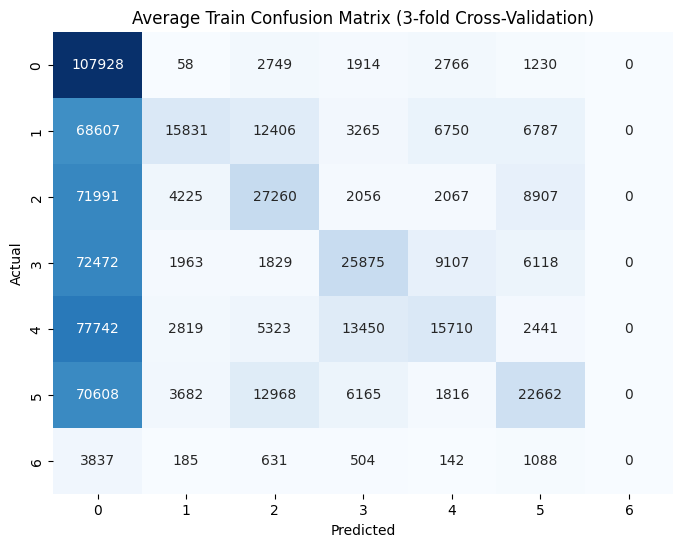

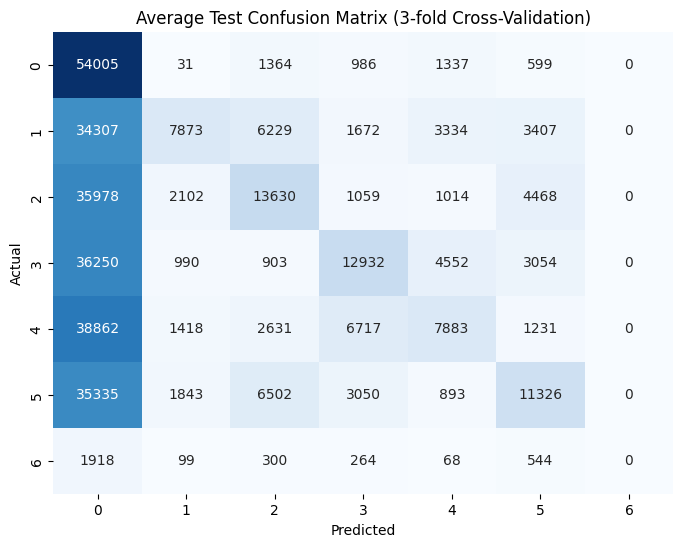

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import KFold, learning_curve
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import confusion_matrix

# Inicializar matrices para almacenar las matrices de confusión promedio
average_cm_train = np.zeros((7, 7))  # Ajustar al tamaño necesario
average_cm_test = np.zeros((7, 7))   # Ajustar al tamaño necesario

# Configurar la validación cruzada con K-Fold (en este caso, 3 splits)
kf = KFold(n_splits=3)
fold_runs = 0  # Seguimiento de las iteraciones
final_score = 0  # Puntaje final

# Iterar sobre los splits de la validación cruzada
for train_index, test_index in kf.split(X_train):
    # Configurar y entrenar el modelo MLP en el conjunto de entrenamiento actual
    mlp = MLPClassifier(hidden_layer_sizes=(3, 3, 3), activation='tanh', solver='adam', max_iter=1000)
    fold_runs += 1
    mlp.fit(X_train[train_index], y_train[train_index])

    # Predecir las etiquetas en el conjunto de prueba y el conjunto de entrenamiento
    y_pred_test = mlp.predict(X_train[test_index])
    y_pred_train = mlp.predict(X_train[train_index])

    # Calcular la matriz de confusión para el conjunto de prueba y el conjunto de entrenamiento
    cm_test = confusion_matrix(y_train[test_index], y_pred_test)
    cm_train = confusion_matrix(y_train[train_index], y_pred_train)

    # Calcular el puntaje de clasificación para el conjunto de prueba
    outVal = mlp.score(X_train[test_index], y_train[test_index])
    final_score += outVal

    # Actualizar las matrices de confusión promedio
    average_cm_test[:cm_test.shape[0], :cm_test.shape[1]] += cm_test
    average_cm_train[:cm_train.shape[0], :cm_train.shape[1]] += cm_train

# Calcular las matrices de confusión promedio dividiendo por el número de ejecuciones de K-Fold
average_cm_train /= fold_runs
average_cm_test /= fold_runs

# Imprimir el puntaje de precisión promedio
print('Accuracy: ' + str(round(final_score * 100 / fold_runs, 2)) + '% after ' + str(fold_runs) + ' runs')

# Mostrar la matriz de confusión promedio para el conjunto de entrenamiento
plt.figure(figsize=(8, 6))
sns.heatmap(np.floor(average_cm_train), annot=True, fmt="g", cmap="Blues", cbar=False)
plt.title('Average Train Confusion Matrix ({}-fold Cross-Validation)'.format(fold_runs))
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Mostrar la matriz de confusión promedio para el conjunto de prueba
plt.figure(figsize=(8, 6))
sns.heatmap(np.floor(average_cm_test), annot=True, fmt="g", cmap="Blues", cbar=False)
plt.title('Average Test Confusion Matrix ({}-fold Cross-Validation)'.format(fold_runs))
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()


Como podemos observar se obtuvo  un avarage de 30.5% por lo tanto nuestro modelo esta cometiendo muchos errores, en la mayoria de los casos confunde muchos datos con la muestra 0, se decide incrementar el numero de neuronas y probar otra funcion de activación:
1. K-fold con 4 divisiones, 4 capas de neuronas , 6 neuronas por capa, funcion de activacion de relu, solver 'adam, max iteraciones 10000

Accuracy: 32.41% after 4 runs


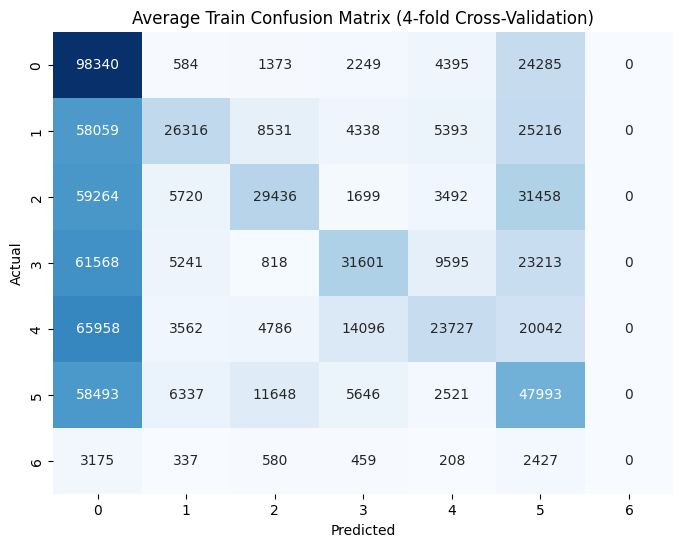

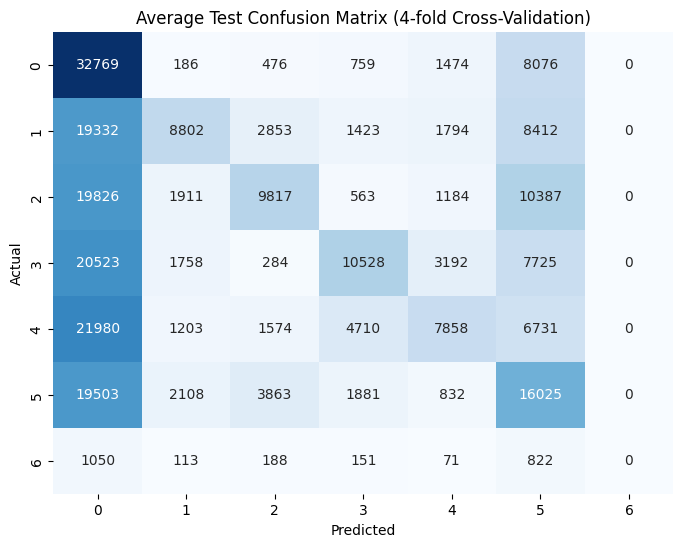

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import KFold, learning_curve
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import confusion_matrix

# Inicializar matrices para almacenar las matrices de confusión promedio
average_cm_train = np.zeros((7, 7))  # Ajustar al tamaño necesario
average_cm_test = np.zeros((7, 7))   # Ajustar al tamaño necesario

# Configurar la validación cruzada con K-Fold (en este caso, 4 splits)
kf = KFold(n_splits=4)
fold_runs = 0  # Seguimiento de las iteraciones
final_score = 0  # Puntaje final

# Iterar sobre los splits de la validación cruzada
for train_index, test_index in kf.split(X_train):
    # Configurar y entrenar el modelo MLP en el conjunto de entrenamiento actual
    mlp = MLPClassifier(hidden_layer_sizes=(6, 6, 6,6), activation='tanh', solver='adam', max_iter=1000)
    fold_runs += 1
    mlp.fit(X_train[train_index], y_train[train_index])

    # Predecir las etiquetas en el conjunto de prueba y el conjunto de entrenamiento
    y_pred_test = mlp.predict(X_train[test_index])
    y_pred_train = mlp.predict(X_train[train_index])

    # Calcular la matriz de confusión para el conjunto de prueba y el conjunto de entrenamiento
    cm_test = confusion_matrix(y_train[test_index], y_pred_test)
    cm_train = confusion_matrix(y_train[train_index], y_pred_train)

    # Calcular el puntaje de clasificación para el conjunto de prueba
    outVal = mlp.score(X_train[test_index], y_train[test_index])
    final_score += outVal

    # Actualizar las matrices de confusión promedio
    average_cm_test[:cm_test.shape[0], :cm_test.shape[1]] += cm_test
    average_cm_train[:cm_train.shape[0], :cm_train.shape[1]] += cm_train

# Calcular las matrices de confusión promedio dividiendo por el número de ejecuciones de K-Fold
average_cm_train /= fold_runs
average_cm_test /= fold_runs

# Imprimir el puntaje de precisión promedio
print('Accuracy: ' + str(round(final_score * 100 / fold_runs, 2)) + '% after ' + str(fold_runs) + ' runs')

# Mostrar la matriz de confusión promedio para el conjunto de entrenamiento
plt.figure(figsize=(8, 6))
sns.heatmap(np.floor(average_cm_train), annot=True, fmt="g", cmap="Blues", cbar=False)
plt.title('Average Train Confusion Matrix ({}-fold Cross-Validation)'.format(fold_runs))
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Mostrar la matriz de confusión promedio para el conjunto de prueba
plt.figure(figsize=(8, 6))
sns.heatmap(np.floor(average_cm_test), annot=True, fmt="g", cmap="Blues", cbar=False)
plt.title('Average Test Confusion Matrix ({}-fold Cross-Validation)'.format(fold_runs))
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()


Aunque el accuracy aumentó no consideramos que haya sido un valor significativo, por lo tanto procedemos a modificar nuevamente nuestra estructura
1. K-fold con 3 divisiones, 4 capas de neuronas ,10, 8 , 4 ,2 neuronas por capa, funcion de activacion de tanh, solver 'adam, max iteraciones 10000


Accuracy: 28.79% after 3 runs


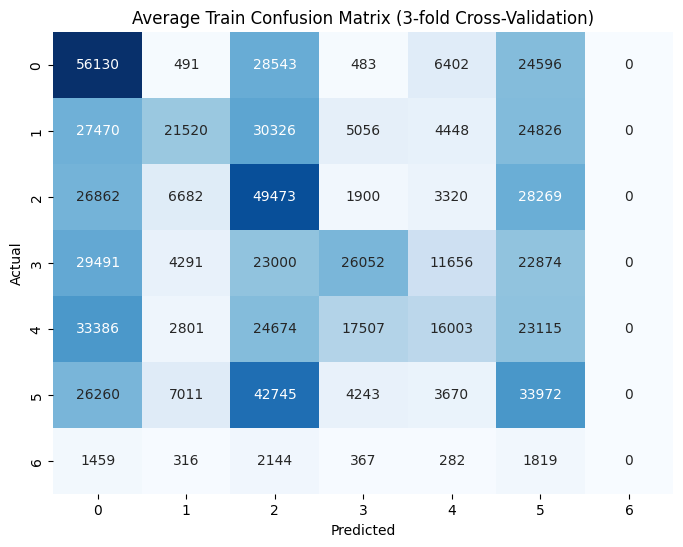

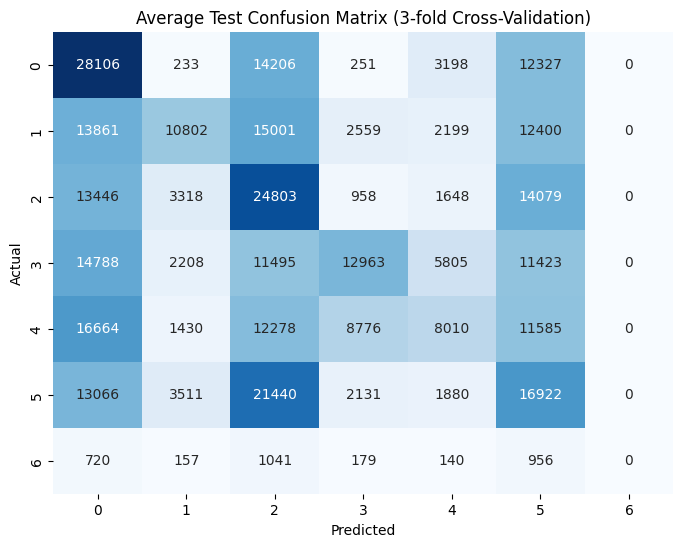

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import KFold, learning_curve
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import confusion_matrix

# Inicializar matrices para almacenar las matrices de confusión promedio
average_cm_train = np.zeros((7, 7))  # Ajustar al tamaño necesario
average_cm_test = np.zeros((7, 7))   # Ajustar al tamaño necesario

# Configurar la validación cruzada con K-Fold (en este caso, 4 splits)
kf = KFold(n_splits=3)
fold_runs = 0  # Seguimiento de las iteraciones
final_score = 0  # Puntaje final

# Iterar sobre los splits de la validación cruzada
for train_index, test_index in kf.split(X_train):
    # Configurar y entrenar el modelo MLP en el conjunto de entrenamiento actual
    mlp = MLPClassifier(hidden_layer_sizes=(10, 8, 4,2), activation='tanh', solver='adam', max_iter=10000)
    fold_runs += 1
    mlp.fit(X_train[train_index], y_train[train_index])

    # Predecir las etiquetas en el conjunto de prueba y el conjunto de entrenamiento
    y_pred_test = mlp.predict(X_train[test_index])
    y_pred_train = mlp.predict(X_train[train_index])

    # Calcular la matriz de confusión para el conjunto de prueba y el conjunto de entrenamiento
    cm_test = confusion_matrix(y_train[test_index], y_pred_test)
    cm_train = confusion_matrix(y_train[train_index], y_pred_train)

    # Calcular el puntaje de clasificación para el conjunto de prueba
    outVal = mlp.score(X_train[test_index], y_train[test_index])
    final_score += outVal

    # Actualizar las matrices de confusión promedio
    average_cm_test[:cm_test.shape[0], :cm_test.shape[1]] += cm_test
    average_cm_train[:cm_train.shape[0], :cm_train.shape[1]] += cm_train

# Calcular las matrices de confusión promedio dividiendo por el número de ejecuciones de K-Fold
average_cm_train /= fold_runs
average_cm_test /= fold_runs

# Imprimir el puntaje de precisión promedio
print('Accuracy: ' + str(round(final_score * 100 / fold_runs, 2)) + '% after ' + str(fold_runs) + ' runs')

# Mostrar la matriz de confusión promedio para el conjunto de entrenamiento
plt.figure(figsize=(8, 6))
sns.heatmap(np.floor(average_cm_train), annot=True, fmt="g", cmap="Blues", cbar=False)
plt.title('Average Train Confusion Matrix ({}-fold Cross-Validation)'.format(fold_runs))
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Mostrar la matriz de confusión promedio para el conjunto de prueba
plt.figure(figsize=(8, 6))
sns.heatmap(np.floor(average_cm_test), annot=True, fmt="g", cmap="Blues", cbar=False)
plt.title('Average Test Confusion Matrix ({}-fold Cross-Validation)'.format(fold_runs))
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()


Sin embargo, al vez el bajo rendimiento obtenido con los datos procesados decidimos intentarlo con los datos procesados para comparar el modelo mas eficiente, por lo tanto nuevamente importamos todos los datos EMG y los procesamos nuevamente eliminando la columna 'time' y revisando que en la columna class no hayan datos NaN para eliminar estas filas.

In [ ]:
from google.colab import drive

# Montar Google Drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
import os
import pandas as pd

# Ruta de la carpeta que contiene los datos
ruta_base = '/content/drive/MyDrive/PROYECTO FINAL/EMG_data_for_gestures-master'

# Lista para almacenar los datos de los archivos TXT
datos = []

# Recorrer las subcarpetas numeradas del 01 al 36
for i in range(1, 37):
    # Ruta de la subcarpeta actual
    ruta_subcarpeta = os.path.join(ruta_base, f'{i:02}')

    # Obtener la lista de archivos TXT en la subcarpeta
    archivos_txt = [archivo for archivo in os.listdir(ruta_subcarpeta) if archivo.endswith('.txt')]

    # Recorrer los archivos TXT en la subcarpeta
    for archivo in archivos_txt:
        # Leer el archivo TXT y cargar los datos en un DataFrame
        df = pd.read_csv(os.path.join(ruta_subcarpeta, archivo), delimiter='\t')

        # Agregar los datos al listado
        datos.append(df)

# Concatenar todos los DataFrames en uno solo
df_final = pd.concat(datos, ignore_index=True)

# Mostrar las primeras filas del DataFrame final
print(df_final.head())


   time  channel1  channel2  channel3  channel4  channel5  channel6  channel7  \
0     1   0.00001  -0.00002  -0.00001  -0.00003   0.00000  -0.00001   0.00000   
1     5   0.00001  -0.00002  -0.00001  -0.00003   0.00000  -0.00001   0.00000   
2     6  -0.00001   0.00001   0.00002   0.00000   0.00001  -0.00002  -0.00001   
3     7  -0.00001   0.00001   0.00002   0.00000   0.00001  -0.00002  -0.00001   
4     8  -0.00001   0.00001   0.00002   0.00000   0.00001  -0.00002  -0.00001   

   channel8  class  
0  -0.00001    0.0  
1  -0.00001    0.0  
2   0.00001    0.0  
3   0.00001    0.0  
4   0.00001    0.0  


In [ ]:
# Contar el número de valores únicos en la columna 'class'
num_valores_unicos = df_final['class'].nunique()

print("Número de valores únicos en la columna 'class':", num_valores_unicos)


Número de valores únicos en la columna 'class': 8


In [ ]:
# Eliminar todas las filas donde el valor de 'class' sea igual a 0.0
df_final = df_final[df_final['class'] != 0.0]

# Reiniciar los índices del DataFrame después de eliminar filas
df_final.reset_index(drop=True, inplace=True)

# Mostrar las primeras filas del DataFrame después de eliminar las filas
df_final.head()


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,class
0,2400,-0.00001,0.00000,-0.00001,0.00000,0.00000,-0.00001,-0.00001,0.00001,1.0
1,2401,-0.00001,-0.00002,0.00000,-0.00001,-0.00001,-0.00001,-0.00003,-0.00002,1.0
2,2402,-0.00001,-0.00002,0.00000,-0.00001,-0.00001,-0.00001,-0.00003,-0.00002,1.0
3,2403,-0.00001,-0.00002,0.00000,-0.00001,-0.00001,-0.00001,-0.00003,-0.00002,1.0
4,2404,-0.00001,-0.00002,0.00000,-0.00001,-0.00001,-0.00001,-0.00003,-0.00002,1.0


In [ ]:
# Contar el número de valores únicos en la columna 'class'
num_valores_unicos = df_final['class'].nunique()

print("Número de valores únicos en la columna 'class':", num_valores_unicos)


Número de valores únicos en la columna 'class': 7


In [ ]:
# Contar el número de datos por gesto
datos_por_gesto = df_final['class'].value_counts()

print("Número de datos por gesto:")
print(datos_por_gesto)


Número de datos por gesto:
class
6.0    253009
5.0    251733
4.0    251570
1.0    250055
3.0    249494
2.0    243193
7.0     13696
Name: count, dtype: int64


In [ ]:
# Eliminar la columna 'time' del DataFrame
df_final = df_final.drop(columns=['time'])

# Mostrar las primeras filas del DataFrame después de eliminar la columna 'time'
print(df_final.head())


   channel1  channel2  channel3  channel4  channel5  channel6  channel7  \
0  -0.00001   0.00000  -0.00001   0.00000   0.00000  -0.00001  -0.00001   
1  -0.00001  -0.00002   0.00000  -0.00001  -0.00001  -0.00001  -0.00003   
2  -0.00001  -0.00002   0.00000  -0.00001  -0.00001  -0.00001  -0.00003   
3  -0.00001  -0.00002   0.00000  -0.00001  -0.00001  -0.00001  -0.00003   
4  -0.00001  -0.00002   0.00000  -0.00001  -0.00001  -0.00001  -0.00003   

   channel8  class  
0   0.00001    1.0  
1  -0.00002    1.0  
2  -0.00002    1.0  
3  -0.00002    1.0  
4  -0.00002    1.0  


In [ ]:
# Verificar si hay valores NaN en alguna columna
nan_en_columnas = df_final.isna().any()

# Mostrar qué columnas tienen valores NaN
print(nan_en_columnas)


channel1    False
channel2    False
channel3    False
channel4    False
channel5    False
channel6    False
channel7    False
channel8    False
class        True
dtype: bool


In [ ]:
df_final.dropna(subset=['class'], inplace=True)


In [ ]:
# Verificar si hay valores NaN en alguna columna
nan_en_columnas = df_final.isna().any()

# Mostrar qué columnas tienen valores NaN
print(nan_en_columnas)


channel1    False
channel2    False
channel3    False
channel4    False
channel5    False
channel6    False
channel7    False
channel8    False
class       False
dtype: bool


In [ ]:
# Imprimir el tamaño del DataFrame (número de filas y columnas)
print("Tamaño del DataFrame:")
df_final.shape


Tamaño del DataFrame:


(1512750, 9)

In [ ]:
# Mostrar una descripción estadística del DataFrame
print("Descripción del DataFrame:")
df_final.describe()

Descripción del DataFrame:


,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,class
count,1.512750e+06,1.512750e+06,1.512750e+06,1.512750e+06,1.512750e+06,1.512750e+06,1.512750e+06,1.512750e+06,1.512750e+06
mean,-8.058932e-06,-9.672596e-06,-9.623831e-06,-9.377584e-06,-1.893733e-05,-1.172764e-05,-9.882056e-06,-1.055507e-05,3.545724e+00
std,1.908015e-04,1.364532e-04,1.374796e-04,2.636300e-04,3.169493e-04,2.500048e-04,1.761816e-04,2.015609e-04,1.733837e+00
min,-1.280000e-03,-1.280000e-03,-1.280000e-03,-1.280000e-03,-1.280000e-03,-1.280000e-03,-1.280000e-03,-1.280000e-03,1.000000e+00
25%,-5.000000e-05,-4.000000e-05,-5.000000e-05,-8.000000e-05,-1.300000e-04,-9.000000e-05,-6.000000e-05,-6.000000e-05,2.000000e+00
50%,-1.000000e-05,-1.000000e-05,-1.000000e-05,-1.000000e-05,-1.000000e-05,-1.000000e-05,-1.000000e-05,-1.000000e-05,4.000000e+00
75%,4.000000e-05,3.000000e-05,4.000000e-05,6.000000e-05,9.000000e-05,7.000000e-05,4.000000e-05,4.000000e-05,5.000000e+00
max,1.270000e-03,1.270000e-03,1.270000e-03,1.270000e-03,1.270000e-03,1.270000e-03,1.270000e-03,1.270000e-03,7.000000e+00


In [ ]:
# Step 3 - Creating Arrays for the Features and the Response Variable
target_column = ['class']
predictors = list(set(df_final.columns) - set(target_column))

# Normalizar las características (predictors)
df_final[predictors] = df_final[predictors] / df_final[predictors].max()

# Mostrar una descripción estadística del DataFrame después de la normalización
print("Descripción del DataFrame después de la normalización:")
print(df_final.describe())


Descripción del DataFrame después de la normalización:
           channel1      channel2      channel3      channel4      channel5  \
count  1.512750e+06  1.512750e+06  1.512750e+06  1.512750e+06  1.512750e+06   
mean  -6.345616e-03 -7.616218e-03 -7.577820e-03 -7.383924e-03 -1.491128e-02   
std    1.502374e-01  1.074435e-01  1.082517e-01  2.075827e-01  2.495664e-01   
min   -1.007874e+00 -1.007874e+00 -1.007874e+00 -1.007874e+00 -1.007874e+00   
25%   -3.937008e-02 -3.149606e-02 -3.937008e-02 -6.299213e-02 -1.023622e-01   
50%   -7.874016e-03 -7.874016e-03 -7.874016e-03 -7.874016e-03 -7.874016e-03   
75%    3.149606e-02  2.362205e-02  3.149606e-02  4.724409e-02  7.086614e-02   
max    1.000000e+00  1.000000e+00  1.000000e+00  1.000000e+00  1.000000e+00   

           channel6      channel7      channel8         class  
count  1.512750e+06  1.512750e+06  1.512750e+06  1.512750e+06  
mean  -9.234364e-03 -7.781146e-03 -8.311078e-03  3.545724e+00  
std    1.968542e-01  1.387257e-01  1.5870

In [ ]:
import numpy as np
from sklearn.model_selection import train_test_split

# Step 4 - Creating the Training and Test Datasets
X = df_final[predictors].values
y = df_final[target_column].values

# Se utiliza la misma semilla para obtener los mismos resultados al dividir
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=40)
y_test = np.squeeze(y_test)
y_train = np.squeeze(y_train)
print(X_train.shape)
print(y_train.shape)

print(X_test.shape)
print(y_test.shape)


(1058925, 8)
(1058925,)
(453825, 8)
(453825,)


Accuracy: 62.95% after 3 runs


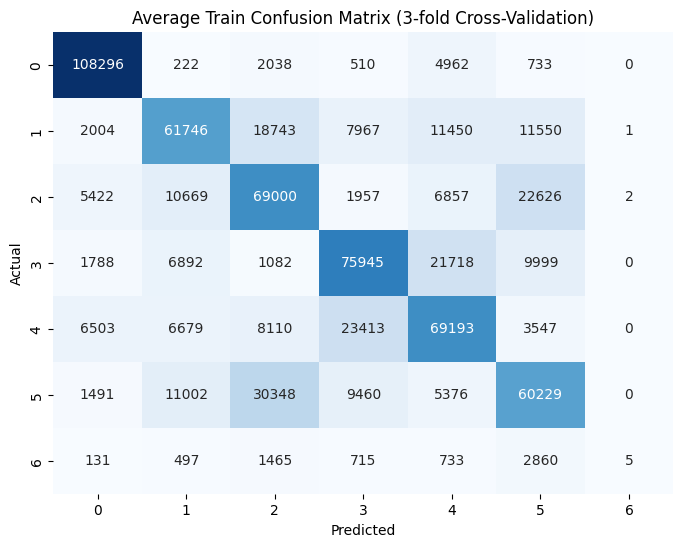

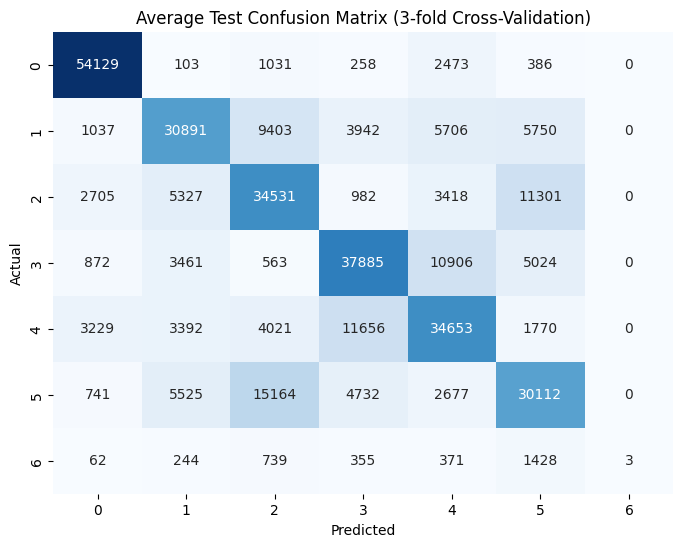

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import KFold, learning_curve
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import confusion_matrix

# Inicializar matrices para almacenar las matrices de confusión promedio
average_cm_train = np.zeros((7, 7))  # Ajustar al tamaño necesario
average_cm_test = np.zeros((7, 7))   # Ajustar al tamaño necesario

# Configurar la validación cruzada con K-Fold (en este caso, 3 splits)
kf = KFold(n_splits=3)
fold_runs = 0  # Seguimiento de las iteraciones
final_score = 0  # Puntaje final

# Iterar sobre los splits de la validación cruzada
for train_index, test_index in kf.split(X_train):
    # Configurar y entrenar el modelo MLP en el conjunto de entrenamiento actual
    mlp = MLPClassifier(hidden_layer_sizes=(10, 10, 10,10), activation='relu', solver='adam', max_iter=1000000)
    fold_runs += 1
    mlp.fit(X_train[train_index], y_train[train_index])

    # Predecir las etiquetas en el conjunto de prueba y el conjunto de entrenamiento
    y_pred_test = mlp.predict(X_train[test_index])
    y_pred_train = mlp.predict(X_train[train_index])

    # Calcular la matriz de confusión para el conjunto de prueba y el conjunto de entrenamiento
    cm_test = confusion_matrix(y_train[test_index], y_pred_test)
    cm_train = confusion_matrix(y_train[train_index], y_pred_train)

    # Calcular el puntaje de clasificación para el conjunto de prueba
    outVal = mlp.score(X_train[test_index], y_train[test_index])
    final_score += outVal

    # Actualizar las matrices de confusión promedio
    average_cm_test[:cm_test.shape[0], :cm_test.shape[1]] += cm_test
    average_cm_train[:cm_train.shape[0], :cm_train.shape[1]] += cm_train

# Calcular las matrices de confusión promedio dividiendo por el número de ejecuciones de K-Fold
average_cm_train /= fold_runs
average_cm_test /= fold_runs

# Imprimir el puntaje de precisión promedio
print('Accuracy: ' + str(round(final_score * 100 / fold_runs, 2)) + '% after ' + str(fold_runs) + ' runs')

# Mostrar la matriz de confusión promedio para el conjunto de entrenamiento
plt.figure(figsize=(8, 6))
sns.heatmap(np.floor(average_cm_train), annot=True, fmt="g", cmap="Blues", cbar=False)
plt.title('Average Train Confusion Matrix ({}-fold Cross-Validation)'.format(fold_runs))
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Mostrar la matriz de confusión promedio para el conjunto de prueba
plt.figure(figsize=(8, 6))
sns.heatmap(np.floor(average_cm_test), annot=True, fmt="g", cmap="Blues", cbar=False)
plt.title('Average Test Confusion Matrix ({}-fold Cross-Validation)'.format(fold_runs))
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()



Se realizaron, por lo tanto, dos modelos para predecir datos EMG: en uno se aplicó un filtro y el operador TKEO a la señal, mientras que al otro se le enviaron los datos crudos. El modelo que utilizó los datos crudos mostró un rendimiento superior. Esto podría deberse a varias razones.

En primer lugar, al aplicar el filtro, es posible que se hayan perdido señales de interés, lo que podría haber eliminado información útil para el modelo. Los filtros, aunque son efectivos para reducir el ruido, también pueden atenuar componentes de la señal que son relevantes para la predicción.

Además, la aplicación del operador TKEO, diseñado para realzar las características de la señal, podría haber modificado el rango del ruido de una manera que no benefició al modelo. En algunos casos, el TKEO puede amplificar el ruido o alterar la señal de manera que se pierdan patrones importantes que el modelo necesita para hacer predicciones precisas.

Por lo tanto, aunque la preprocesamiento de las señales puede ser beneficioso para ciertos tipos de análisis, en este caso, los datos crudos proporcionaron al modelo la información completa y sin distorsiones necesarias para un mejor rendimiento.

## **f. (25%) Consultar (10%), justificar el uso (5%) e implementar otros modelos de machine learning que permitan la clasificación de gestos (10%)**

### Modelos de Machine Learning para la Clasificación de Gestos

seleccionar el modelo adecuado de Machine Learning es crucial para abordar problemas complejos como la clasificación de gestos de manera efectiva.

#### 1. **Regresión Logística (Logistic Regression)**
La regresión logística es un modelo de clasificación lineal que estima la probabilidad de que una instancia pertenezca a una clase particular. Para la clasificación de gestos, este modelo podría utilizarse para predecir la probabilidad de que un gesto específico esté presente en una señal EMG. Es adecuado para problemas binarios y multiclase. La principal ventaja de la regresión logística es su simplicidad y eficiencia computacional, lo que lo hace útil para aplicaciones en tiempo real. Sin embargo, su limitación radica en su incapacidad para capturar relaciones no lineales en los datos de gestos más complejos.

#### 2. **Máquinas de Vectores de Soporte (Support Vector Machines - SVM)**
Las SVM encuentran el hiperplano que mejor separa las clases en el espacio de características. Para la clasificación de gestos, las SVM podrían utilizarse para identificar patrones en los datos de señales EMG que representen gestos específicos. Son adecuadas para problemas de clasificación binaria y multiclase, especialmente cuando se enfrentan a datos de alta dimensión. Las ventajas de las SVM incluyen su capacidad para manejar eficazmente espacios de alta dimensión y su robustez ante el sobreajuste. Sin embargo, pueden requerir un ajuste cuidadoso de parámetros y ser menos eficientes con conjuntos de datos muy grandes.

#### 3. **Árboles de Decisión (Decision Trees)**
Los árboles de decisión clasifican ejemplos dividiendo los datos en subconjuntos basados en características de entrada. Para la clasificación de gestos, los árboles de decisión podrían utilizarse para identificar combinaciones de características EMG que sean indicativas de gestos específicos. Son fáciles de interpretar y manejan bien datos no lineales, lo que los hace útiles para comprender los patrones en los datos de gestos. Sin embargo, son propensos al sobreajuste y pueden ser inestables con cambios pequeños en los datos.

#### 4. **Bosques Aleatorios (Random Forests)**
Los bosques aleatorios construyen múltiples árboles de decisión y fusionan sus predicciones para mejorar la precisión y controlar el sobreajuste. Para la clasificación de gestos, los bosques aleatorios podrían utilizarse para combinar las predicciones de múltiples modelos y mejorar la robustez del sistema al identificar gestos en señales EMG con alta variabilidad. Son robustos ante el sobreajuste y manejan bien la variabilidad de los datos. Sin embargo, son menos interpretables que un solo árbol de decisión y pueden ser computacionalmente intensivos para aplicaciones en tiempo real.


# **Random Forest:**

Accuracy: 40.15% after 4 runs


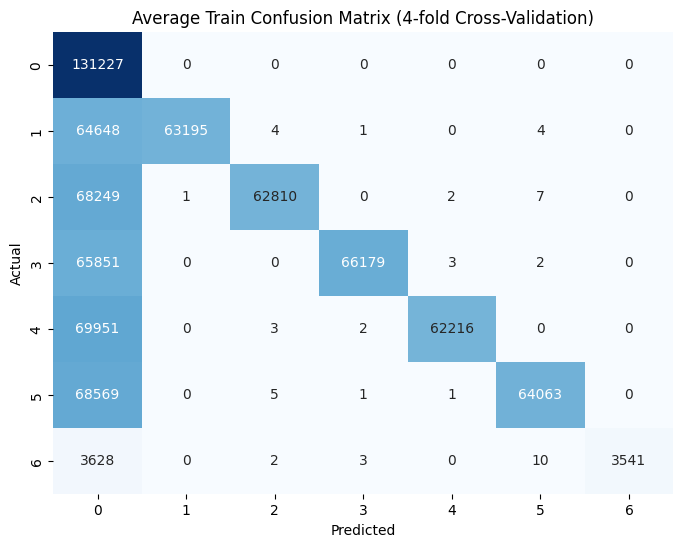

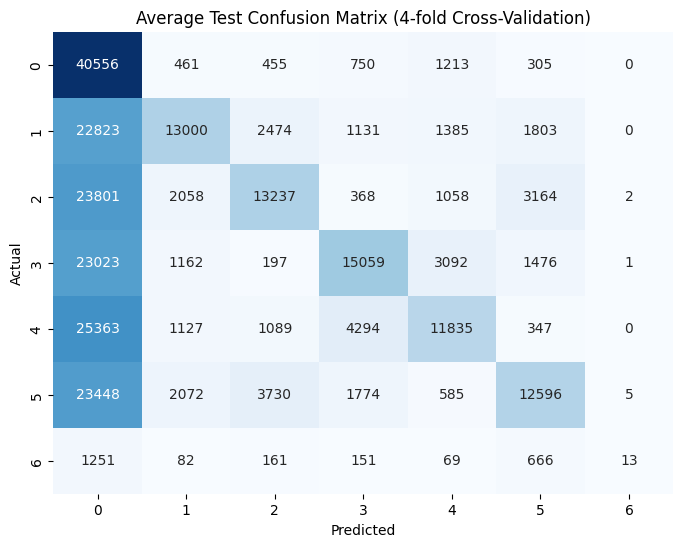

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import KFold
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix

def calculate_confusion_matrices(X_train, y_train, n_splits=4, n_estimators=100, max_depth=None, random_state=42):
    # Inicializar matrices para almacenar las matrices de confusión promedio
    num_classes = len(np.unique(y_train))
    average_cm_train = np.zeros((num_classes, num_classes))
    average_cm_test = np.zeros((num_classes, num_classes))

    # Configurar la validación cruzada con K-Fold
    kf = KFold(n_splits=n_splits)
    fold_runs = 0
    final_score = 0

    # Iterar sobre los splits de la validación cruzada
    for train_index, test_index in kf.split(X_train):
        rf = RandomForestClassifier(n_estimators=n_estimators, max_depth=max_depth, random_state=random_state)
        fold_runs += 1
        rf.fit(X_train[train_index], y_train[train_index])

        y_pred_test = rf.predict(X_train[test_index])
        y_pred_train = rf.predict(X_train[train_index])

        cm_test = confusion_matrix(y_train[test_index], y_pred_test)
        cm_train = confusion_matrix(y_train[train_index], y_pred_train)

        outVal = rf.score(X_train[test_index], y_train[test_index])
        final_score += outVal

        average_cm_test[:cm_test.shape[0], :cm_test.shape[1]] += cm_test
        average_cm_train[:cm_train.shape[0], :cm_train.shape[1]] += cm_train

    average_cm_train /= fold_runs
    average_cm_test /= fold_runs

    return average_cm_train, average_cm_test, final_score / fold_runs

def plot_confusion_matrix(cm, title, fold_runs):
    plt.figure(figsize=(8, 6))
    sns.heatmap(np.floor(cm), annot=True, fmt="g", cmap="Blues", cbar=False)
    plt.title('{} ({}-fold Cross-Validation)'.format(title, fold_runs))
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.show()

# Asegúrate de definir X_train y y_train antes de ejecutar esta parte del código
# X_train = ...
# y_train = ...

# Calcular matrices de confusión promedio y precisión promedio
average_cm_train, average_cm_test, average_accuracy = calculate_confusion_matrices(X_train, y_train)

# Imprimir el puntaje de precisión promedio
print('Accuracy: {:.2f}% after {} runs'.format(average_accuracy * 100, 4))

# Mostrar las matrices de confusión promedio
plot_confusion_matrix(average_cm_train, 'Average Train Confusion Matrix', 4)
plot_confusion_matrix(average_cm_test, 'Average Test Confusion Matrix', 4)


# **Regresión**

Accuracy: 30.08% after 4 runs


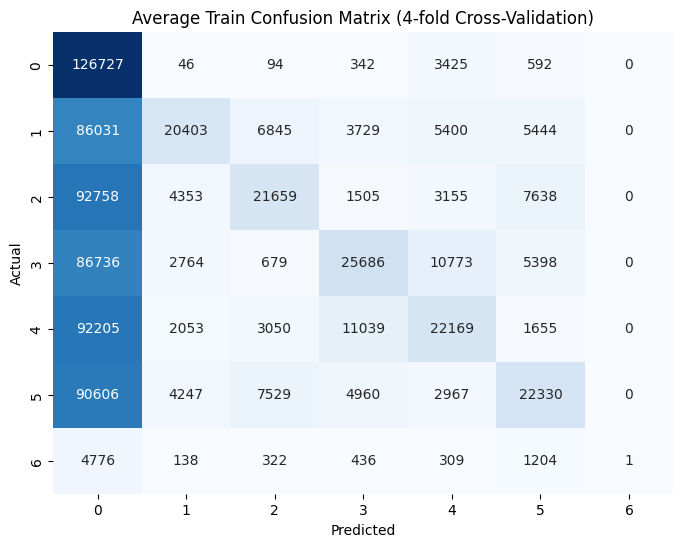

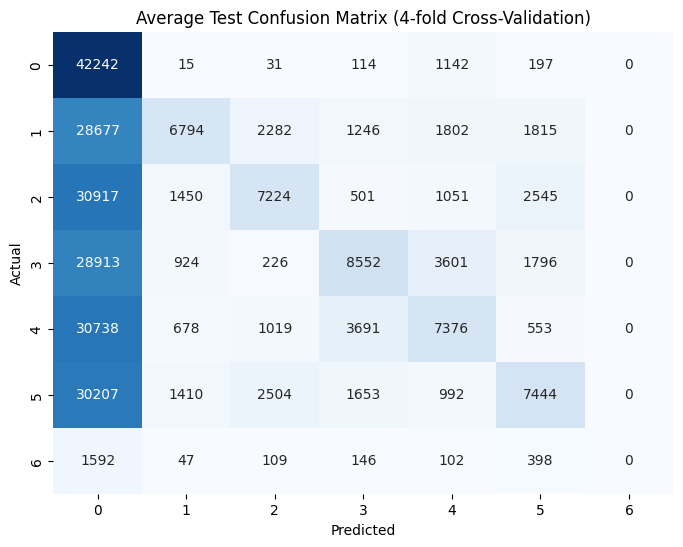

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import KFold
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix

def calculate_confusion_matrices(X_train, y_train, n_splits=4, solver='lbfgs', max_iter=1000, random_state=42):
    # Inicializar matrices para almacenar las matrices de confusión promedio
    num_classes = len(np.unique(y_train))
    average_cm_train = np.zeros((num_classes, num_classes))
    average_cm_test = np.zeros((num_classes, num_classes))

    # Configurar la validación cruzada con K-Fold
    kf = KFold(n_splits=n_splits, shuffle=True, random_state=random_state)
    fold_runs = 0
    final_score = 0

    # Iterar sobre los splits de la validación cruzada
    for train_index, test_index in kf.split(X_train):
        lr = LogisticRegression(solver=solver, max_iter=max_iter, random_state=random_state)
        fold_runs += 1
        lr.fit(X_train[train_index], y_train[train_index])

        y_pred_test = lr.predict(X_train[test_index])
        y_pred_train = lr.predict(X_train[train_index])

        cm_test = confusion_matrix(y_train[test_index], y_pred_test)
        cm_train = confusion_matrix(y_train[train_index], y_pred_train)

        outVal = lr.score(X_train[test_index], y_train[test_index])
        final_score += outVal

        average_cm_test[:cm_test.shape[0], :cm_test.shape[1]] += cm_test
        average_cm_train[:cm_train.shape[0], :cm_train.shape[1]] += cm_train

    average_cm_train /= fold_runs
    average_cm_test /= fold_runs

    return average_cm_train, average_cm_test, final_score / fold_runs

def plot_confusion_matrix(cm, title, fold_runs):
    plt.figure(figsize=(8, 6))
    sns.heatmap(np.floor(cm), annot=True, fmt="g", cmap="Blues", cbar=False)
    plt.title('{} ({}-fold Cross-Validation)'.format(title, fold_runs))
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.show()

# Asegúrate de definir X_train y y_train antes de ejecutar esta parte del código
# X_train = ...
# y_train = ...

# Calcular matrices de confusión promedio y precisión promedio
average_cm_train, average_cm_test, average_accuracy = calculate_confusion_matrices(X_train, y_train)

# Imprimir el puntaje de precisión promedio
print('Accuracy: {:.2f}% after {} runs'.format(average_accuracy * 100, 4))

# Mostrar las matrices de confusión promedio
plot_confusion_matrix(average_cm_train, 'Average Train Confusion Matrix', 4)
plot_confusion_matrix(average_cm_test, 'Average Test Confusion Matrix', 4)


Además de comparar la precisión de los modelos de Random Forest y Regresión Lineal con el modelo de redes neuronales en la clasificación de gestos, es importante considerar otros aspectos como la interpretabilidad y la capacidad de generalización. Los modelos de Random Forest y Regresión Lineal tienden a ser más interpretables que las redes neuronales, lo que facilita entender cómo se llega a una predicción específica. Sin embargo, las redes neuronales, mediante el proceso de backpropagation, pueden ajustar sus pesos durante el entrenamiento para mejorar su capacidad de clasificación. Además, la capacidad de generalización de cada modelo a datos nuevos y no vistos durante el entrenamiento también es crucial para evaluar su rendimiento en situaciones del mundo real. Además de la precisión, la selección de características efectiva en Random Forest y Regresión Lineal, así como los detalles del proceso de entrenamiento y optimización en las redes neuronales, también influyen en el desempeño de cada modelo en la tarea de clasificación de gestos.

# **g. (15%) Discutir cómo se podría implementar la solución del punto e y f usando sistemas embebidos seleccionando el tipo de microcontrolador (5%) y los posibles tiempos de adquisición y clasificación de las señales (10%)**

Para implementar la solución del punto e y f utilizando sistemas embebidos, necesitaríamos seleccionar un microcontrolador adecuado y considerar los posibles tiempos de adquisición y clasificación de las señales. Aquí hay una propuesta:

### Selección del tipo de microcontrolador:
Para esta aplicación, sería prudente elegir un microcontrolador con suficiente potencia de procesamiento y capacidad de entrada/salida para manejar la adquisición de señales EMG y la ejecución de los algoritmos de clasificación de gestos en tiempo real. Algunos microcontroladores populares para aplicaciones embebidas incluyen:

-Arduino: El Arduino se utiliza como microcontrolador, el cual hace interfaz entre el ordenador y otro dispositivo, este ejecuta una determinada tarea que se le da por medio de un programa que se encuentra en el ordenador, y traduce esta tarea en una acción y viceversa, debido a los sensores y actuadores.
Los arduinos suelen ser utilizados por la fácilidad de usoy amplio conocimiento sobre estos, puede ser Arduino Uno, Arduino Nano o Arduino Mega.

- PIC: Si bien se considera que los microcontroladores PIC son de un uso más complejo, también son eficientes, al tener un largo tiempo en el mercado, es fácil acceder a distintos programas, sin embargo es posible que no se tenga la potencia suficiente para ejecutar programas más complejos.

- Microcontroladores MSP430:Tienen muy bajo consumo de energia, sin embargo su rendimiento y potencia no son tan altos.

-Microcontroladores AVR:tiene facilidad de uso, utiliza una memoria Flash en chip para almacenar la memoria de los programas. Su arquitectura RISC peromiten que tenga un alto rendimiento y un bajo consumo de energía, son populares por su eficienci ay capacidad de procesamiento.

-Microcontroladores ARM Cortex-M: Los modelos de ARM Cortex-M cono el STM32 y el ESP32, suelen ser muy utilizados debido a que tienen un buen rendimiento al mismo tiempo de eficiencia energetico, por lo tanto en caso de hacer una aplicación enbebida que requiera el procesamiento en tiempo real es muy buena opción.

Para el caso de este proyecto se llega a la conclusión que si se desea realizar por medio de un sistema embebido, un microcontrolador de modelo ARM Cortex-M, seria una buena opción por lo anteriormente mencionado, además se observa que en la bibliografia, en los proyectos en el cual se hace un análisis de gestos, estos son comunmente usados.

Por ejemplo en proyectos como Implementación de aplicaciones Deep Learning en microcontroladoresARM Cortex- en el cual se considera el ESP32 para obtener las señales y entrenar el modelo[4]. En el trabajo de Sistema de control basado en la detección de gestos de los dedos [5], en el cual se utiliza tambien el ESP32, debido a su capacidad de memoria y procesamiento, en el cual dan todas sus especificaciones. Por último en un sistema de Control de un sistema de información para bomberos mediante gestos de la mano, se considero el uso de este tipo de microcontrolador ESP32 con doble nucleo para adquirir la señal por medio de un guante [6].


### Posibles tiempos de adquisición y clasificación de señales:
Los tiempos de adquisición y clasificación de señales dependerán de varios factores, incluyendo la frecuencia de muestreo de las señales EMG, la complejidad de los algoritmos de clasificación y la capacidad de procesamiento del microcontrolador.

1. **Adquisición de señales:** Para una señal electromiografica una frecuencia de muestreo de 1000 Hz para así capturar componentes de frecuencia en la señal hasta los 500 Hz, es decir, aplicando el teorema de Nyquist, esto hace que se capture los gestos con mayor precisión, teniendo en cuenta que los tiempos de adquisición por gesto puede estar en milisegundos o seguntos, en este caso dependera tambien de la capacidad del microcontrolador seleccionado.

2. **Clasificación de señales:** La clasificación de gestos cuando se usa algoritmos de aprendizaje automático requieren diferentes tiempos de procesamiento dependiendo de la complejidad del modelo, si es un algoritmo simple, o si se trata de redes neuronales como en este caso, la cantidad de características extraídas de la señal, el número de sensores utilizados para obtener la señal y la capacidad de reloj del microcontrolador usado. Cuando se habla de sistemas embebidos, los tiempos en de la clasificación pueden llegar a varias de segundos hasta milisegundos, dependiendo del tamaño de las caracteristicas musculares al realizar el gesto que entrean al programa.



**Conclusiones**

- Se realiza un filtro FIR ya que estos son diseñados para tener una fase lineal, son esto preserva la forma de la señal original, esto nos ayuda a mantener las caracteristicas más importantes, teniendo en cuenta que se realiza un análisis de gestos que busca clasificar cada uno, es necesario mantener la señal lo más intacta posible.

- En el diagrama de cajas y bigotes se puede observar que al aplicar el filtro hay menos varianza que en la señal original, lo cual nos indica que el filtro realizo su función, sin embargo se puede observar que los datos estan en el rango de la señal original, por lo cual mantenemos las caracteristicas originales de la señal.

- Al realizar los modelos de entrenamiento se puede observar que no es posible obtener un accuracy alto con la señal filtrada, lo cual nos indica que al filtrar se estan eliminando datos de interes que no permite el correcto entrenamiento del modelo.

- Al realizar el modelo de entrenamiento con los datos de la señal original el accuracy aumento hasta 62,95 indicando un muy buen procesamiento, sin embargo, el modelo se ve limitado por la capacidad de computo que se tiene en el momento del procesamiento. En cuanto al gesto 7, se puede observar que la cantidad de datos dispuestos son mucho menor que la de los otros gestos, por lo cual se puede observar que no se reconoce muy bien, sin embargo, al realizar el procesamiento con los datos originales se logra entrenar un poco más.



[1]Fundación Aquae. (2020, 30 octubre). ¿Sabes qué es un Arduino y para qué sirve? - Fundación Aquae. https://www.fundacionaquae.org/wiki/sabes-arduino-sirve/#:~:text=1.,gracias%20a%20sensores%20y%20actuadores.

[2]Electronics, A. (2022, 13 octubre). Microcontroladores AVR para procesamiento de 8 bits de alto rendimiento y consumo eficiente de energía. Arrow.com. https://www.arrow.com/es-mx/research-and-events/articles/avr-microcontrollers-for-high-performance-and-power-efficient-8-bit-processing


[3]Microcontroladores basados en Arm | TI.com. (s. f.). https://www.ti.com/es-mx/microcontrollers-mcus-processors/arm-based-microcontrollers/overview.html

[4]Queipo, S. Q. (s. f.). Implementación de aplicaciones deep learning en microconytoladores. oa.upm.es. https://oa.upm.es/71117/1/TFG_SANTIAGO_JUAN_QUEIPO_DE_LLANO_MAZZUCHELLI.pdf

[5]CONDORI, W. C. (2023, mayo). SISTEMA DE CONTROL BASADO EN LA DETECCIÓN DE GESTOS DE LOS DEDOS. repositorio.umsa.bo. https://repositorio.umsa.bo/bitstream/handle/123456789/34783/EG-3026.pdf?sequence=1&isAllowed=y

[6]Paracuellos, D. P. (2020, 15 noviembre). CONTROL DE UN SISTEMA DE INFORMACIÓN PARA BOMBEROS MEDIANTE GESTOS DE LA MANO. riunet.upv.es. https://riunet.upv.es/bitstream/handle/10251/156883/Paracuellos%20-%20Control%20de%20un%20sistema%20de%20informaci%c3%b3n%20para%20bomberos%20mediante%20gestos%20de%20la%20mano.pdf?sequence=1&isAllowed=y

[7]Ortega, A., Vega, G., & Ruíz, N. (s. f.). Adquisición y Procesamiento de una Señal Electromiográfica para control de una Prótesis. somi.ccadet.unam.mx. http://somi.ccadet.unam.mx/somi29/memoriassomi29/PDFS/electronica/129-AOSOMI-99-129.pdf
